In [1]:
import os

import numpy as np
import pandas as pd
import torch
import scipy.stats

import scanpy as sc
from anndata import AnnData

import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.colors as mcolors
import matplotlib.lines as mlines

data_dir="../../data/AD/processed1/"
result_dir = "../edges/"
raw_type=False
use_edge=False
genes= torch.load("/".join(data_dir.split("/")[:-2]) + "/genes.pth")
print(genes)

sample='H20.33.001.CX28.MTG.02.007.1.02.03'

['PRRT4', 'GRIP2', 'FOXP2', 'PDZD2', 'KIAA1217', 'PALMD', 'LRRC4C', 'ASIC2', 'NPAS3', 'LUZP2', 'GRIN2A', 'NLGN1', 'NTNG2', 'TACR1', 'PDGFD', 'ANK1', 'DLX1', 'CBLN2', 'ZNF804A', 'CACNA2D3', 'CDH6', 'CD22', 'ETNPPL', 'CALB1', 'TSHZ2', 'FGF13', 'KIRREL3', 'ROBO1', 'RBFOX3', 'ASTN2', 'ID3', 'TH', 'TENM2', 'ZMAT4', 'CLSTN2', 'SEMA6D', 'HPSE2', 'BTBD11', 'LRP1B', 'NOS1', 'GPC5', 'SNTB1', 'COL11A1', 'TMEM255A', 'SATB2', 'SORCS3', 'FBXL7', 'GRM8', 'GALNTL6', 'NOSTRIN', 'DCC', 'SOX6', 'MEIS2', 'STXBP6', 'SMYD1', 'SCUBE1', 'LAMA4', 'CNTN5', 'GRM7', 'KCNMB2', 'CUX2', 'LAMP5', 'SLIT3', 'TAFA1', 'PRKG1', 'CSMD1', 'CNTNAP5', 'NFIA', 'FRMPD4', 'GRID2', 'HS6ST3', 'SORCS1', 'ATRNL1', 'ADAMTS3', 'SLC24A2', 'RBFOX1', 'TMEM132D', 'NKAIN2', 'PEX5L', 'TNR', 'DGKG', 'RFX3', 'UNC5B', 'HTR2A', 'RGS12', 'CACHD1', 'RORB', 'LRRK1', 'THEMIS', 'CARTPT', 'SLC32A1', 'GAD2', 'MOG', 'DCN', 'TOX', 'ZNF385D', 'PDE4B', 'GRIP1', 'ITGB8', 'PLD5', 'NPY', 'NDNF', 'SEMA3E', 'KAZN', 'DLC1', 'PLCB1', 'HCN1', 'ITGA8', 'EBF1', 'PR

In [2]:
def read_data(sample,add_type_exp=False):
    results=torch.load(result_dir+"edges_"+sample+".pth",map_location=torch.device('cpu'))
    
    position_x=results["position_x"]
    position_y=results["position_y"]
    cell_type_name=results["cell_type_name"]
    loss1=results["loss_all"].cpu()
    
    B,N=position_x.shape
    loss1=loss1.numpy()
    
    cell_type_target=[cell_type_name[i][0] for i in range(len(cell_type_name))]

    type_exp_dict=np.load(data_dir + sample + "_TypeExp.npz", allow_pickle=True)
    type_exps=np.stack([type_exp_dict[cell_typei] for cell_typei in cell_type_target],axis=0)
    
    to_position_x=position_x[:,0].numpy()
    to_position_y=position_y[:,0].numpy()
    
    if not add_type_exp:
        adata = AnnData(results["y_pred"].numpy())#+type_exps)#(np.log(results["y_pred"].numpy()))
    else:
        adata = AnnData(results["y_pred"].numpy()+type_exps)
    adata.obs['cell_type'] = cell_type_target
    adata.obs['to_position_x'] = to_position_x
    adata.obs['to_position_y'] = to_position_y
    adata.obs['loss']=loss1
    adata.var_names=genes

    if not add_type_exp:
        adata1 = AnnData(results["y"].numpy())#+type_exps)#(np.log(results["y"].numpy()))
    else:
        adata1 = AnnData(results["y"].numpy()+type_exps)#(np.log(results["y"].numpy()))
    adata1.obs['cell_type'] = cell_type_target
    adata1.obs['to_position_x'] = to_position_x
    adata1.obs['to_position_y'] = to_position_y
    adata1.obs['loss']=loss1
    adata1.var_names=genes
    
    return adata,adata1

adata_pred,adata_y=read_data(sample)
adata_pred1,adata_y1=read_data(sample,True)
print(adata_y.shape)
print("mse",np.mean(np.square(adata_pred.X-adata_y.X)))
print("abs_mean",np.mean(np.abs(adata_pred.X)),np.mean(np.abs(adata_y.X)))
print("abs_median",np.median(np.abs(adata_pred.X)),np.median(np.abs(adata_y.X)))

(15222, 140)
mse 0.22158574
abs_mean 0.10369525 0.3540508
abs_median 0.054268327 0.20885663


0                L4 IT
1        Microglia-PVM
2              L2/3 IT
3            Astrocyte
4        Microglia-PVM
             ...      
15217       L6 IT Car3
15218            Lamp5
15219            L6 IT
15220        Astrocyte
15221          L2/3 IT
Name: cell_type, Length: 15222, dtype: object


/gpfs/gibbs/project/wang_zuoheng/xx244/conda_envs/torch/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


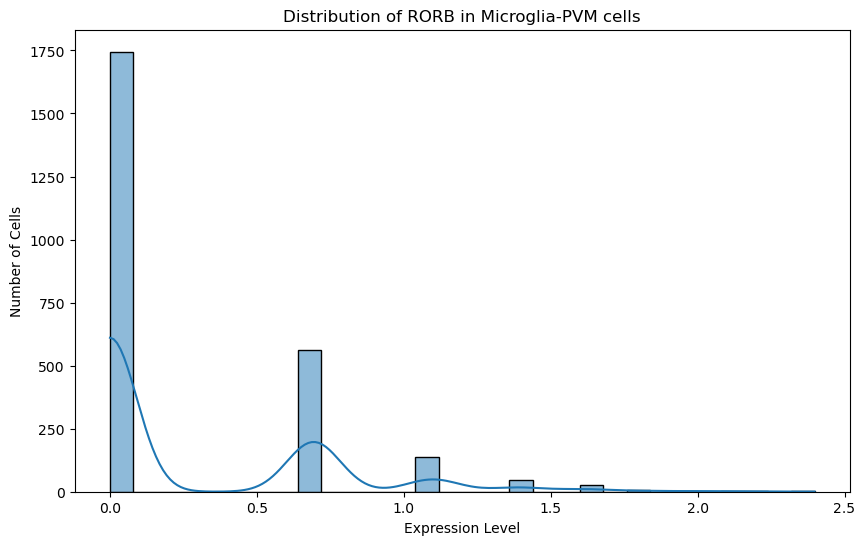

0                L4 IT
1        Microglia-PVM
2              L2/3 IT
3            Astrocyte
4        Microglia-PVM
             ...      
15217       L6 IT Car3
15218            Lamp5
15219            L6 IT
15220        Astrocyte
15221          L2/3 IT
Name: cell_type, Length: 15222, dtype: object


/gpfs/gibbs/project/wang_zuoheng/xx244/conda_envs/torch/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


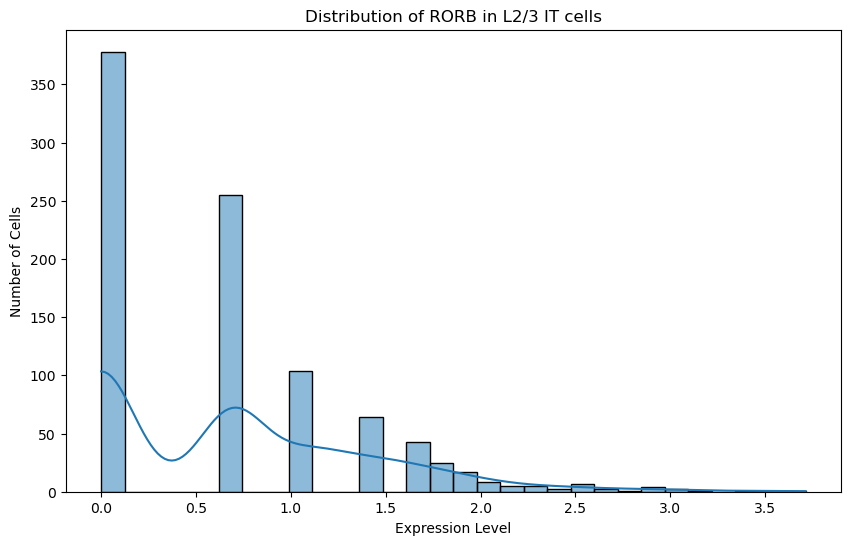

0                L4 IT
1        Microglia-PVM
2              L2/3 IT
3            Astrocyte
4        Microglia-PVM
             ...      
15217       L6 IT Car3
15218            Lamp5
15219            L6 IT
15220        Astrocyte
15221          L2/3 IT
Name: cell_type, Length: 15222, dtype: object


/gpfs/gibbs/project/wang_zuoheng/xx244/conda_envs/torch/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


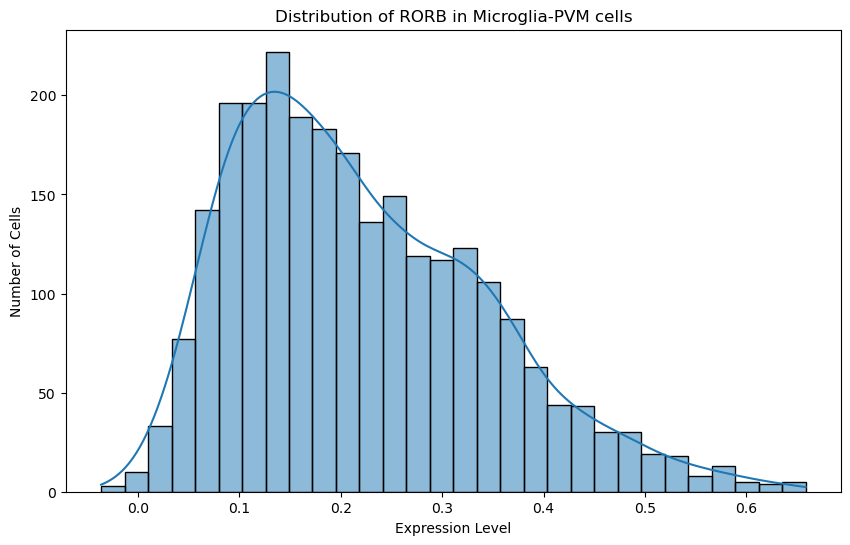

0                L4 IT
1        Microglia-PVM
2              L2/3 IT
3            Astrocyte
4        Microglia-PVM
             ...      
15217       L6 IT Car3
15218            Lamp5
15219            L6 IT
15220        Astrocyte
15221          L2/3 IT
Name: cell_type, Length: 15222, dtype: object


/gpfs/gibbs/project/wang_zuoheng/xx244/conda_envs/torch/lib/python3.9/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


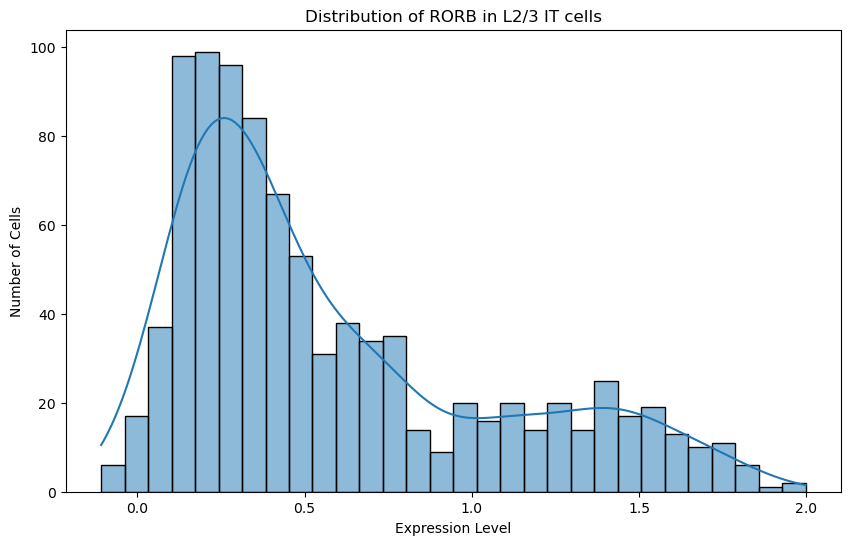

In [3]:
import matplotlib.pyplot as plt
import seaborn as sns

def plot_gene_distribution(adata, cell_type, gene):
    """
    Plot the distribution of expression levels of a specific gene within a specific cell type.

    Parameters:
    - adata (anndata.AnnData): The AnnData object containing the gene expression data.
    - cell_type (str): The cell type to filter on.
    - gene (str): The gene to plot the distribution for.
    """
    # Check if the gene is in the columns of the adata
    if gene not in adata.var_names:
        print(f"Gene '{gene}' not found in the data.")
        return

    # Filter the data for the specified cell type
    print(adata.obs['cell_type'])
    filtered_data = adata[adata.obs['cell_type'] == cell_type]

    # Extract the expression levels of the gene
    gene_expression = filtered_data[:, gene].X
    
    # If the data is stored in a sparse format, convert it to dense
    if hasattr(gene_expression, "todense"):
        gene_expression = gene_expression.todense()
    
    # Flatten the array to 1D
    gene_expression = gene_expression.flatten()

    # Plotting
    plt.figure(figsize=(10, 6))
    sns.histplot(gene_expression, kde=True, bins=30)
    plt.title(f'Distribution of {gene} in {cell_type} cells')
    plt.xlabel('Expression Level')
    plt.ylabel('Number of Cells')
    plt.show()

plot_gene_distribution(adata_y1, 'Microglia-PVM', "RORB")
plot_gene_distribution(adata_y1, 'L2/3 IT', "RORB")

plot_gene_distribution(adata_pred1, 'Microglia-PVM', "RORB")
plot_gene_distribution(adata_pred1, 'L2/3 IT', "RORB")

In [4]:
from scipy.stats import pearsonr

def calculate_pcc_between_adata(adata1, adata2):
    # Extract data matrices
    X1 = adata1.X
    X2 = adata2.X
    
    # Calculate Pearson correlation coefficients
    pcc_results = {}
    for i, gene in enumerate(genes):
        # Extract the gene expression data across all cells for each gene
        gene_expression_1 = X1[:, i]
        gene_expression_2 = X2[:, i]
        
        # Calculate the Pearson correlation coefficient
        pcc, _ = pearsonr(gene_expression_1, gene_expression_2)
        
        # Store the result in the dictionary using the gene name as the key
        pcc_results[gene] = pcc
    
    return pcc_results

pccs_state=calculate_pcc_between_adata(adata_pred,adata_y)
pccs_overall=calculate_pcc_between_adata(adata_pred1,adata_y1)

In [5]:
def normalize_data(data):
    return (data - np.min(data)) / (np.max(data) - np.min(data))

def calculate_pcc(adata1, adata2, gene_name):
    gene_expression1 = adata1.obs_vector(gene_name)
    gene_expression2 = adata2.obs_vector(gene_name)
    correlation_matrix = np.corrcoef(gene_expression1, gene_expression2)
    return correlation_matrix[0, 1]  # PCC between the two gene expressions

def spatial_visualize_gene_(adata, gene_name, is_pred, vmin, vmax, point_size=1, normalize_expression=False, colorbar_size=0.8):
    if gene_name not in adata.var_names:
        raise ValueError(f"Gene '{gene_name}' not found in adata.var_names")

    title = "Predicted expression of " + gene_name if is_pred else "Expression of " + gene_name
    pcc1=pccs_overall[gene_name]
    pcc2=pccs_state[gene_name]
    if is_pred:
        title += f"\nOverall PCC: {pcc1:.2f}; Cell state PCC: {pcc2:.2f}"

    x = adata.obs['to_position_x']
    y = adata.obs['to_position_y']
    gene_expression = adata.obs_vector(gene_name)
    if normalize_expression:
        gene_expression = normalize_data(gene_expression)

    x_range = max(x) - min(x)
    y_range = max(y) - min(y)
    aspect_ratio = x_range / y_range
    fig_width = 8
    fig_height = fig_width / aspect_ratio

    fig, ax = plt.subplots(figsize=(fig_width, fig_height))
    scatter = ax.scatter(x, y, c=gene_expression, cmap='jet', vmin=vmin, vmax=vmax, s=point_size)
    cbar = plt.colorbar(scatter, ax=ax, shrink=colorbar_size)
    ax.set_title(title)
    ax.set_aspect('equal')

    plt.show()

def spatial_visualize_gene(adata_pred, adata_y, gene_name, normalize_expression=False, colorbar_size=0.3):
    ground_truth_values = adata_y.obs_vector(gene_name)
    if normalize_expression:
        vmin, vmax = 0, 1
    else:
        vmin, vmax = ground_truth_values.min(), ground_truth_values.max()

    pcc = calculate_pcc(adata_pred, adata_y, gene_name)

    spatial_visualize_gene_(adata_y, gene_name, False, vmin, vmax, normalize_expression=normalize_expression, colorbar_size=colorbar_size)
    spatial_visualize_gene_(adata_pred, gene_name, True, vmin, vmax, normalize_expression=normalize_expression, colorbar_size=colorbar_size)

print(adata_pred.var_names)

Index(['PRRT4', 'GRIP2', 'FOXP2', 'PDZD2', 'KIAA1217', 'PALMD', 'LRRC4C',
       'ASIC2', 'NPAS3', 'LUZP2',
       ...
       'FGF12', 'LHX6', 'VIP', 'CA10', 'ADAMTSL1', 'CHODL', 'SULF1', 'NRG1',
       'NXPH2', 'TLL1'],
      dtype='object', length=140)


['CD74', 'CLSTN2', 'KCNIP4', 'SLC24A2', 'RBFOX1', 'CUX2', 'EGFR', 'LAMP5', 'FGF12', 'DCLK1', 'HCN1', 'MOG', 'HTR2A', 'SLC14A1', 'GAD2', 'NTNG2', 'DCN', 'HS3ST2', 'FRMPD4', 'RORB', 'TAFA1', 'GRIN2A', 'HS6ST3', 'PLCB1', 'RBFOX3', 'SEMA3E', 'GRIK3', 'CBLN2', 'ATRNL1', 'LRRC4C', 'SORCS1', 'FEZF2', 'PEX5L', 'NKAIN2', 'ROBO2', 'SLIT3', 'GRIN3A', 'CA10', 'DCC', 'TOX', 'TNR', 'NXPH2', 'ETNPPL', 'ITGB8', 'FGF13', 'CNTN5', 'ZMAT4', 'LRRK1', 'DGKG', 'KAZN', 'CACNA2D3', 'SATB2', 'KIAA1217', 'ADAMTS3', 'CSMD1', 'TMEM132D', 'ASTN2', 'TSHZ2', 'GRIP1', 'CARTPT', 'FOXP2', 'NFIA', 'LRP1B', 'RFX3', 'SMYD1', 'KIRREL3', 'CNTNAP5', 'GRM7', 'SORCS3', 'SEMA6D', 'TENM2', 'RGS6', 'STXBP6', 'MEIS2', 'ANK1', 'CACHD1', 'ID3', 'NPAS3', 'NRG1', 'SNTB1', 'SV2C', 'CTSS', 'GPC5', 'DLX1', 'GRID2', 'CDH6', 'PDE4B', 'ZNF804A', 'ITGA8', 'BTBD11', 'LUZP2', 'PDZD2', 'COL11A1', 'GRIP2', 'SULF1', 'TACR1', 'ZNF385D', 'ASIC2', 'UNC5B', 'ROBO1', 'PVALB', 'GRM8', 'SLC32A1', 'DACH1', 'GALNTL6', 'SOX6', 'NOSTRIN', 'PDGFD', 'DLC1', '

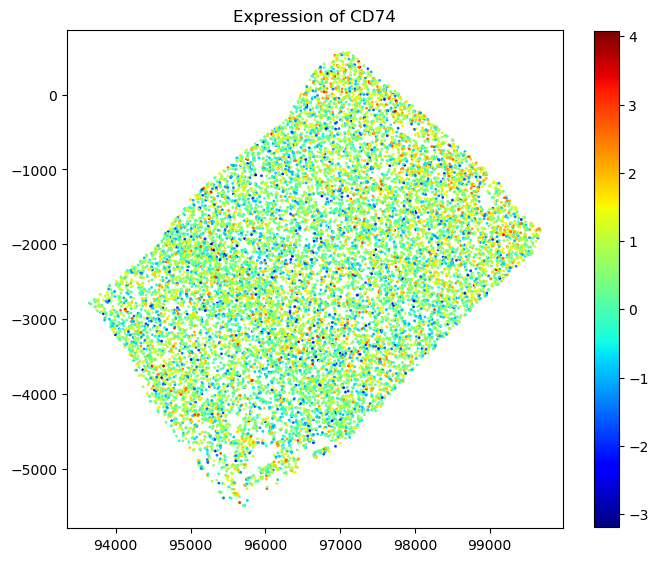

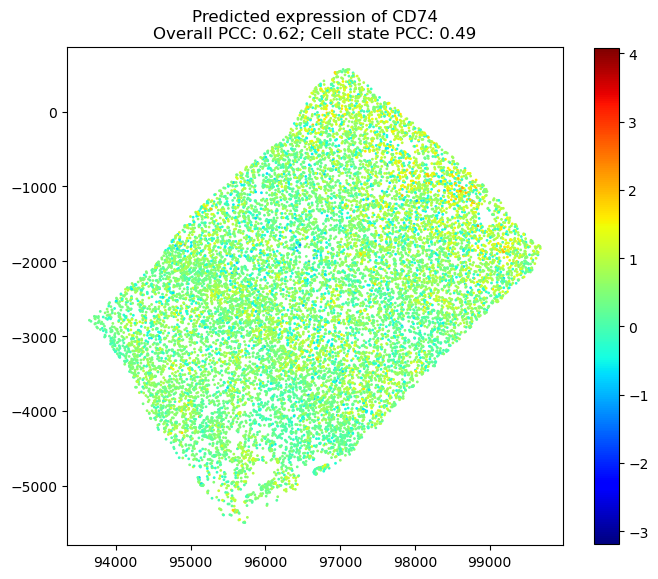

Plotting CLSTN2 with PCC: 0.48


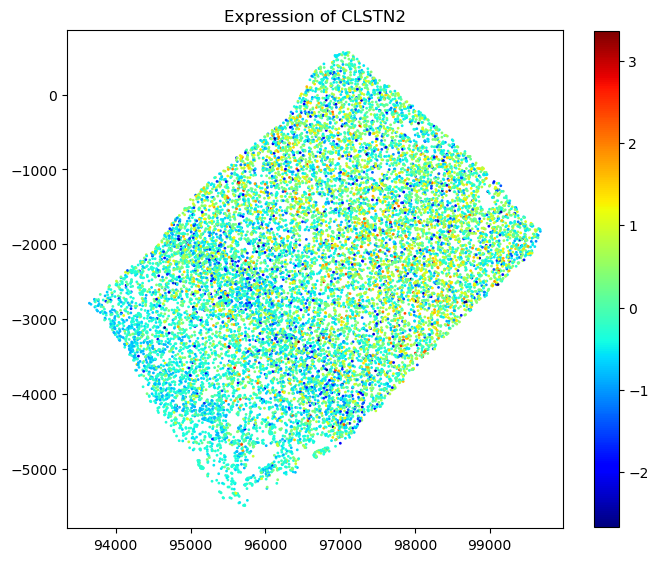

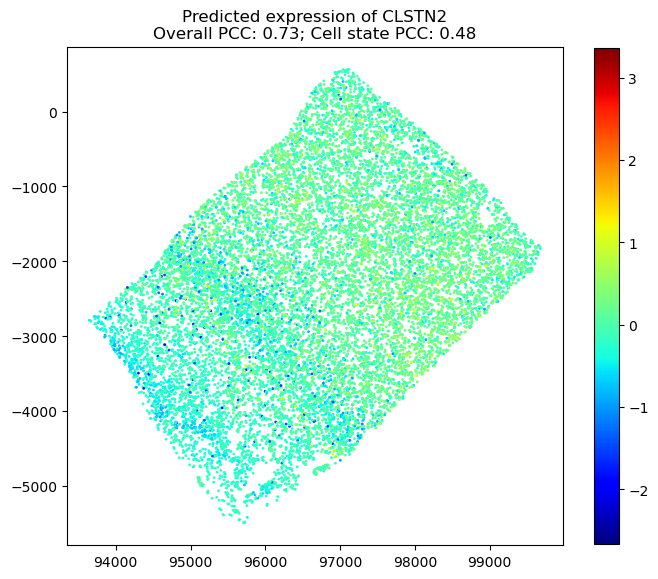

Plotting KCNIP4 with PCC: 0.47


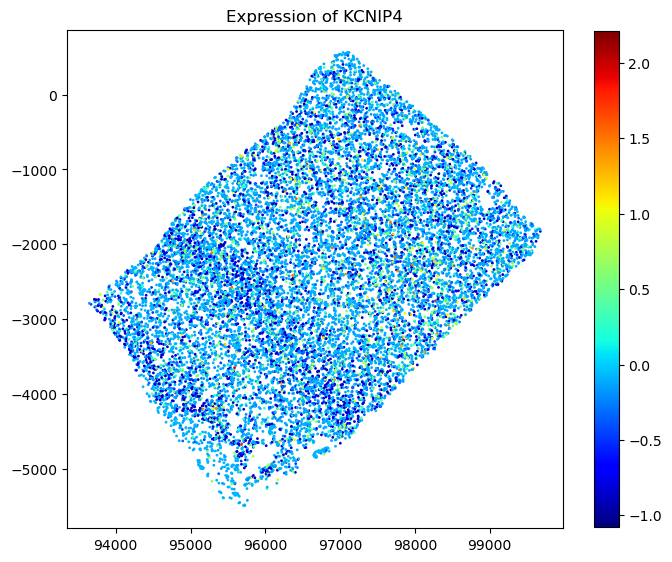

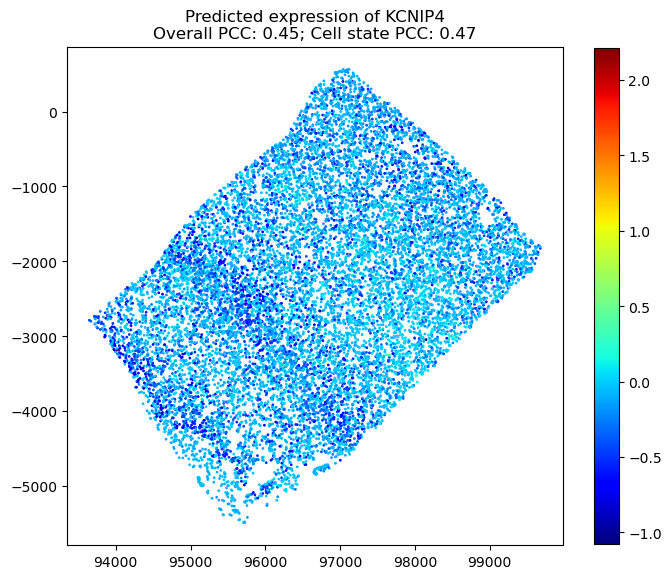

Plotting SLC24A2 with PCC: 0.46


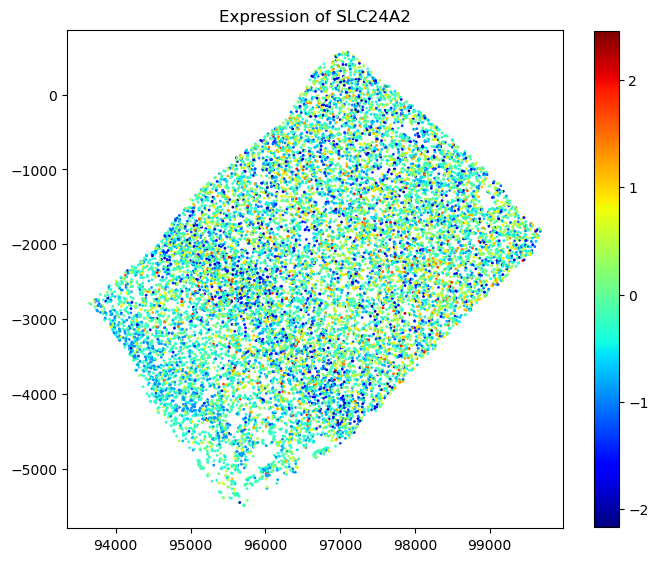

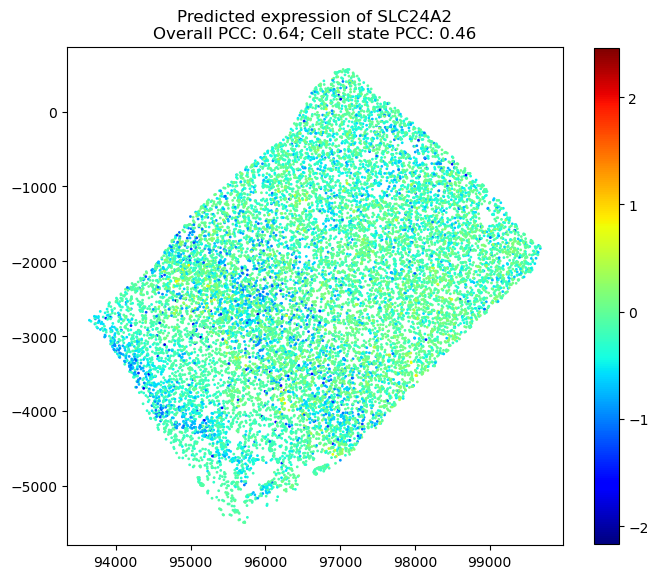

Plotting RBFOX1 with PCC: 0.45


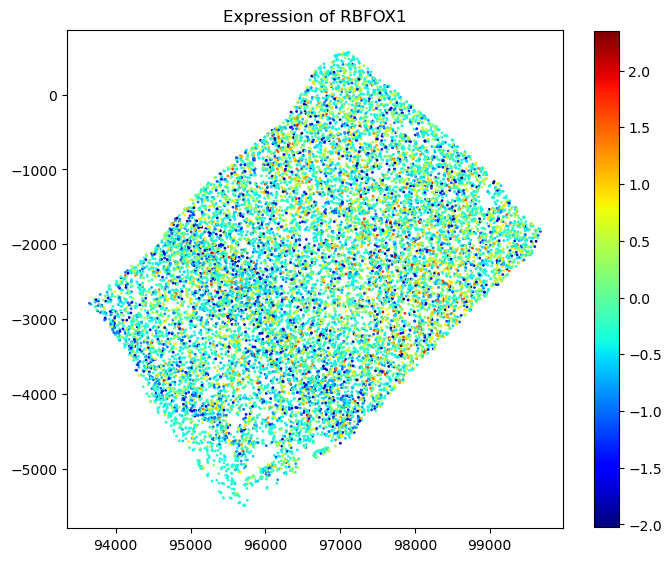

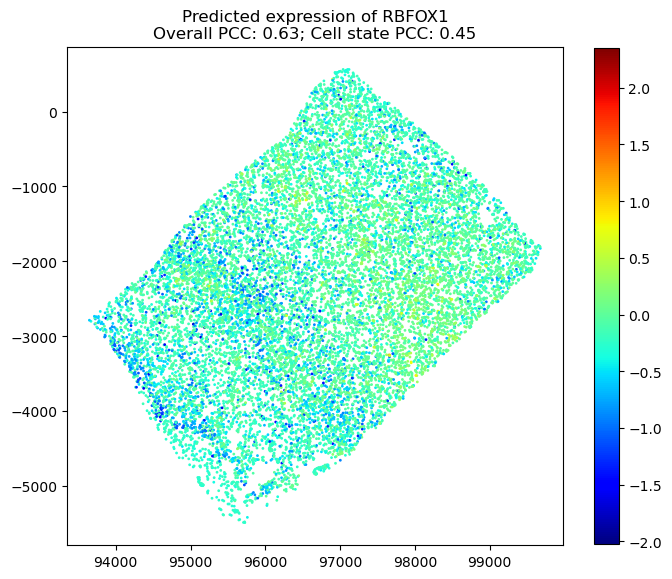

Plotting CUX2 with PCC: 0.44


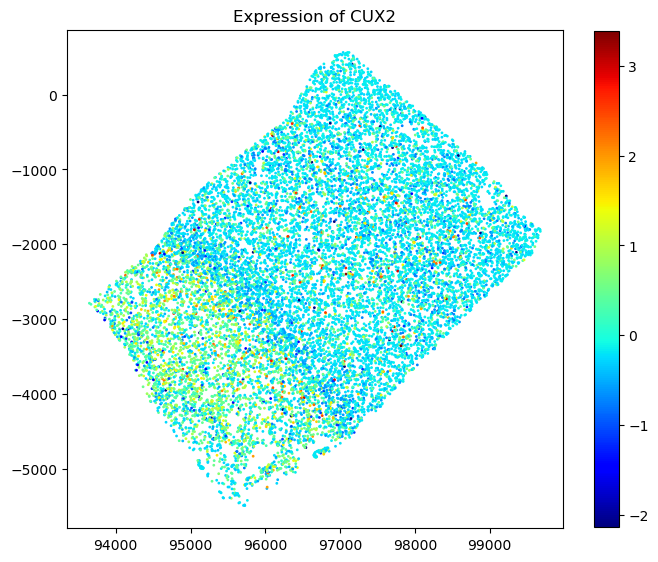

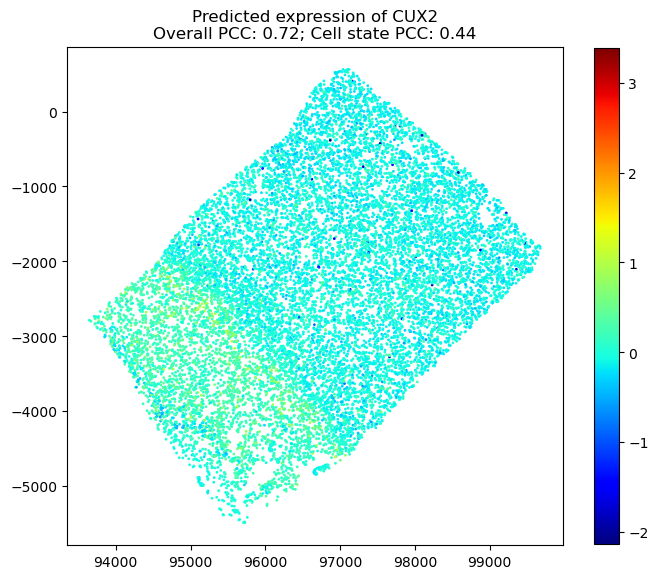

Plotting EGFR with PCC: 0.44


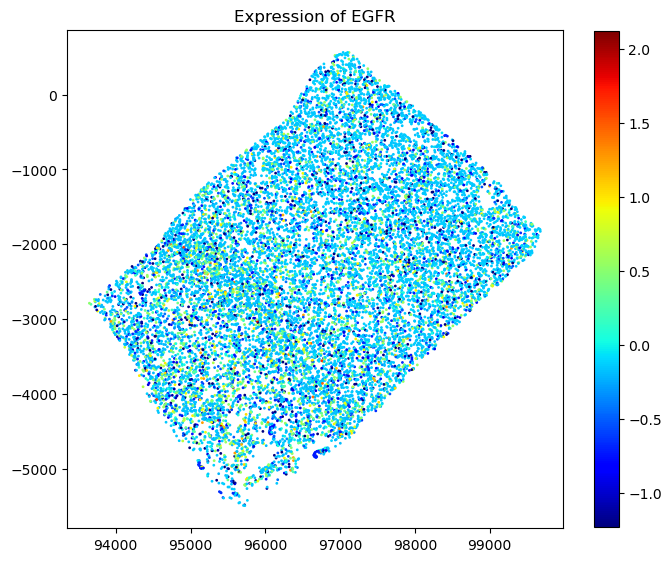

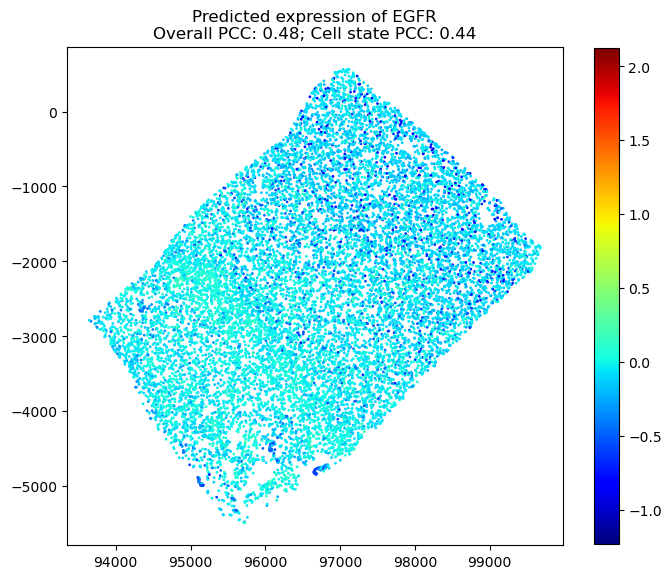

Plotting LAMP5 with PCC: 0.42


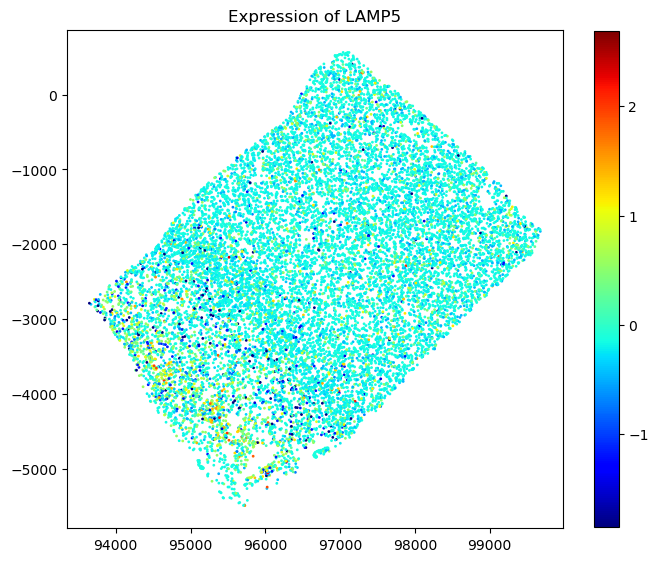

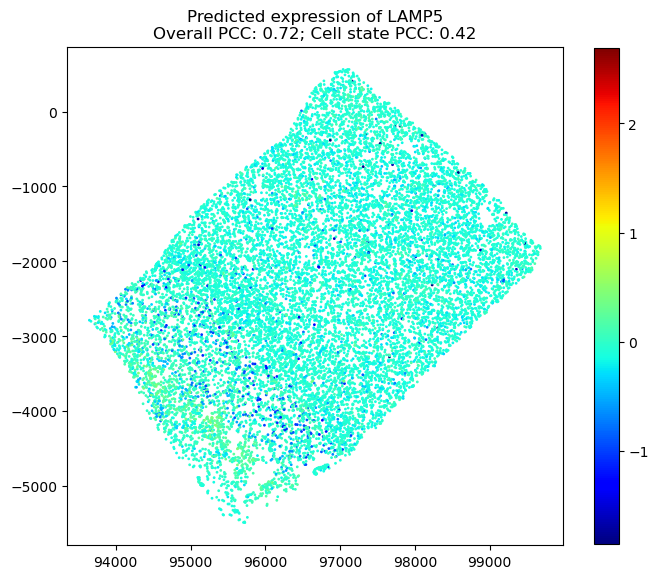

Plotting FGF12 with PCC: 0.42


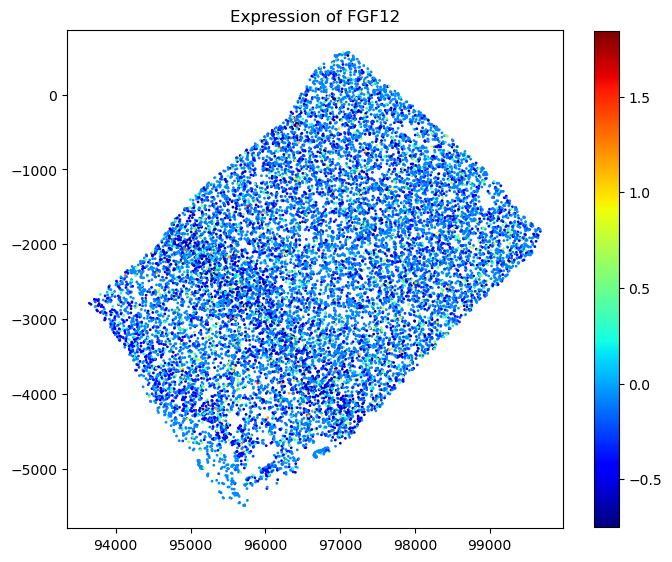

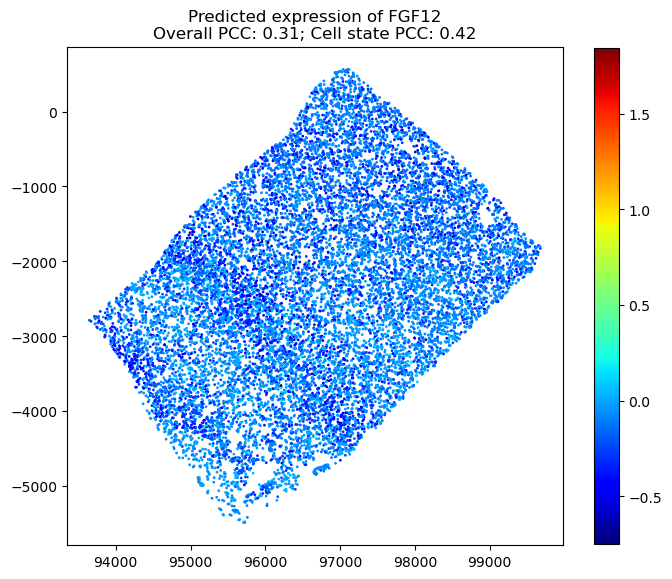

Plotting DCLK1 with PCC: 0.42


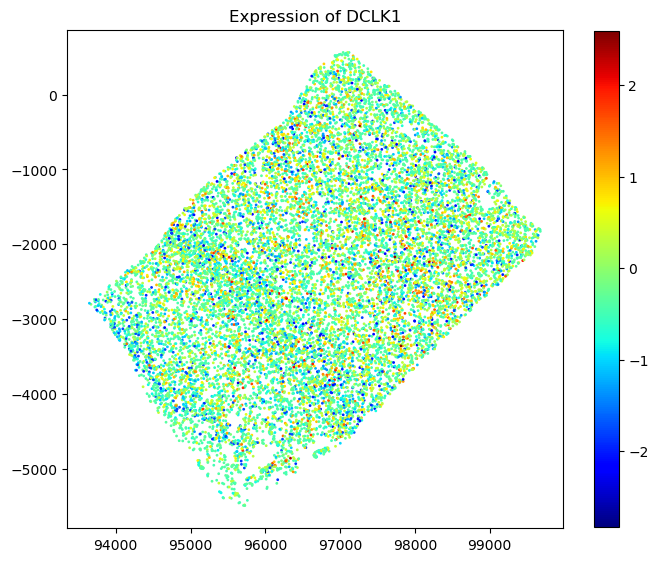

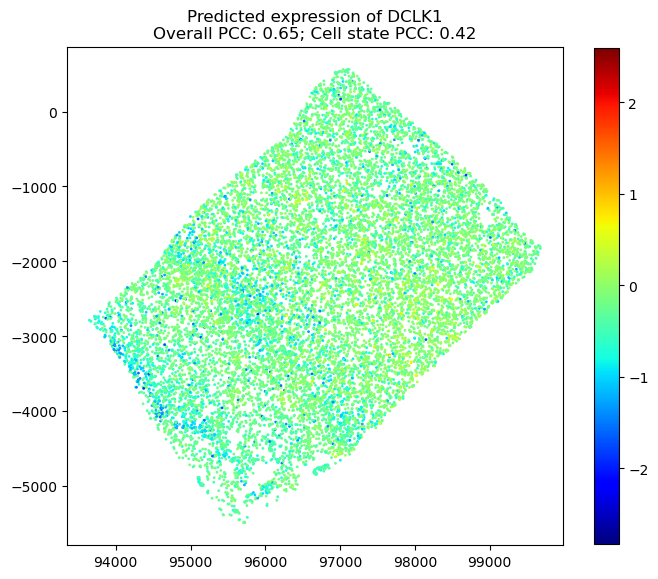

Plotting HCN1 with PCC: 0.41


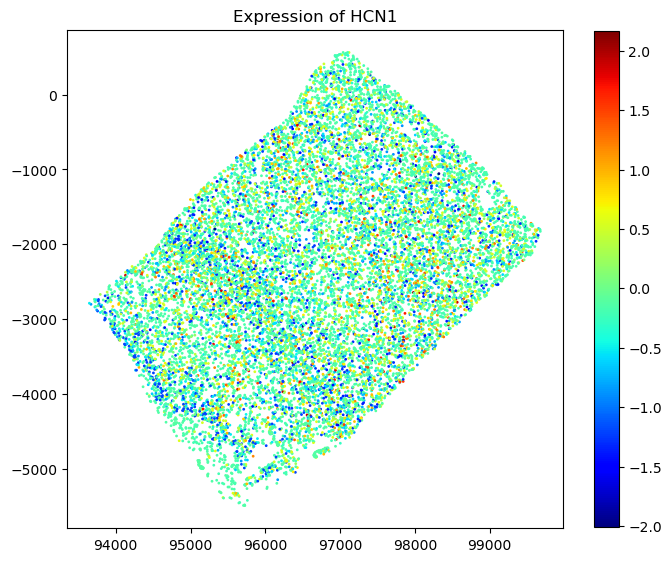

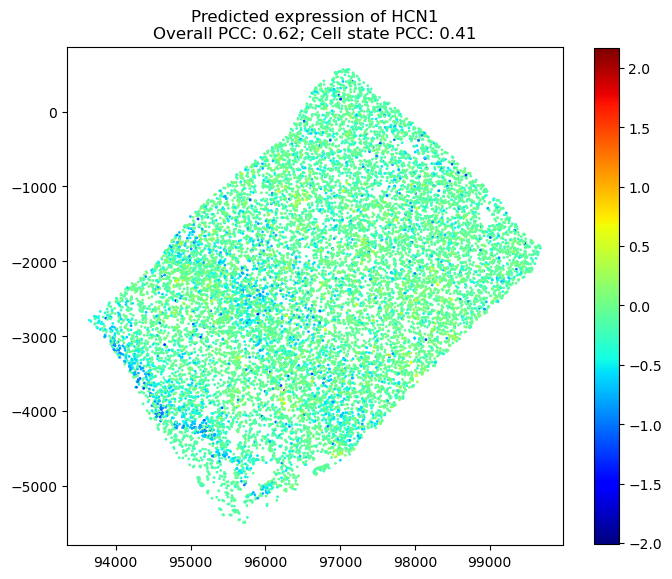

Plotting MOG with PCC: 0.41


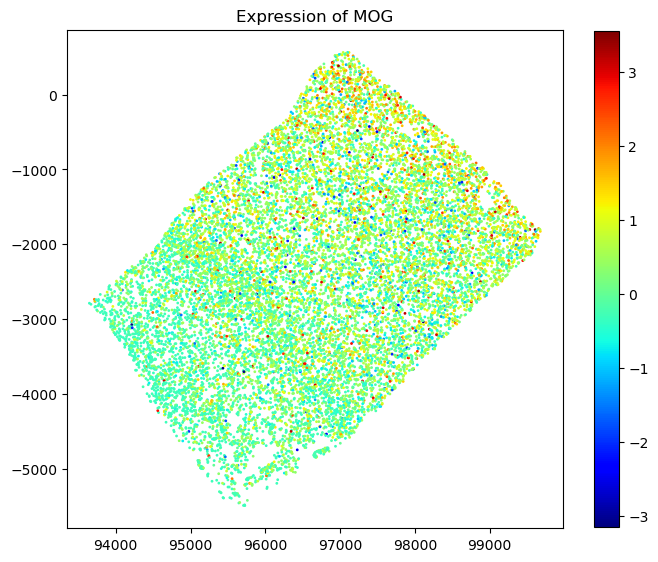

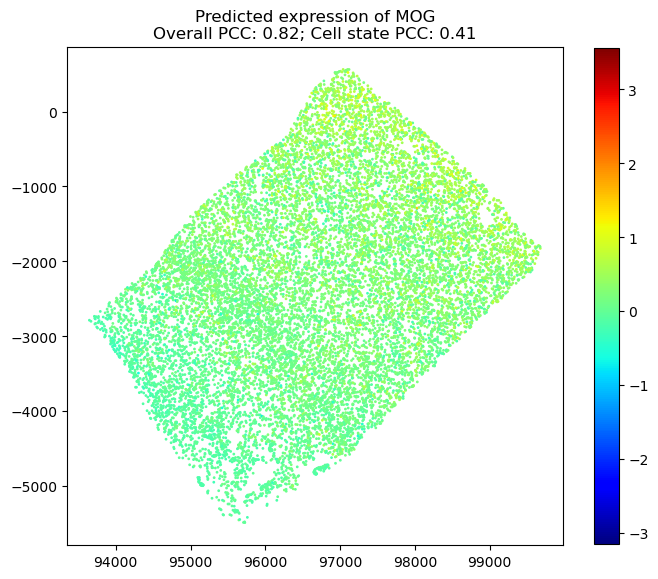

Plotting HTR2A with PCC: 0.41


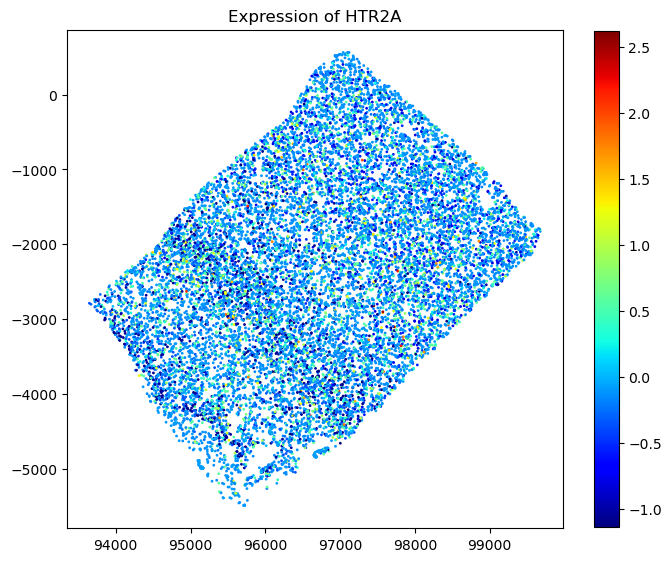

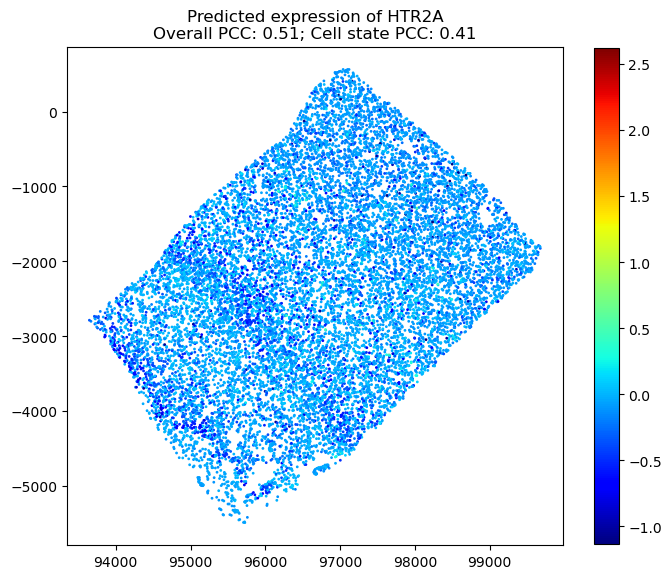

Plotting SLC14A1 with PCC: 0.41


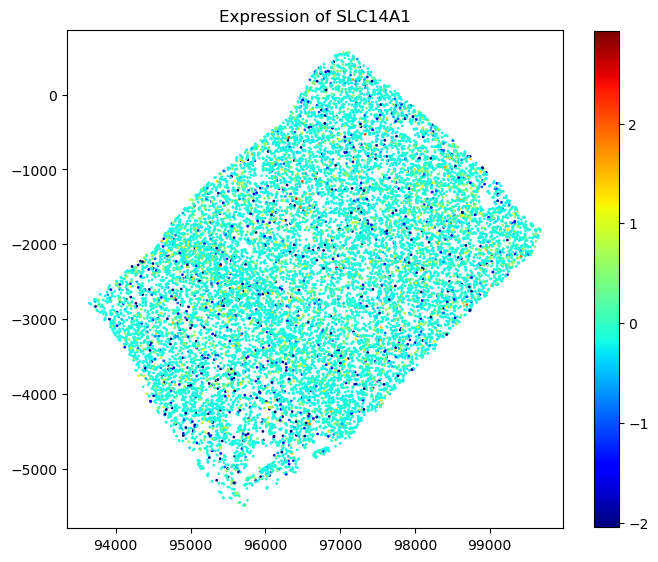

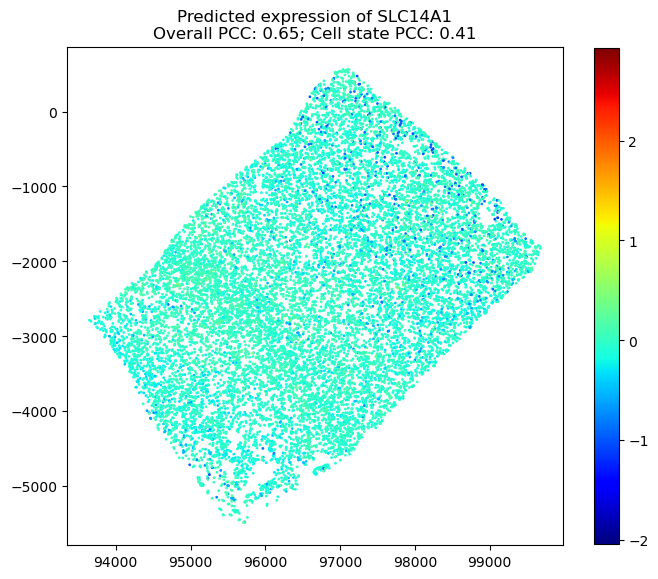

Plotting GAD2 with PCC: 0.40


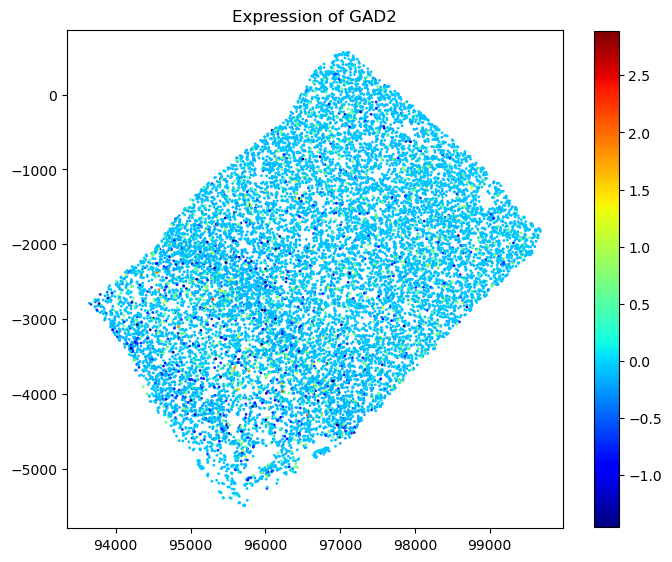

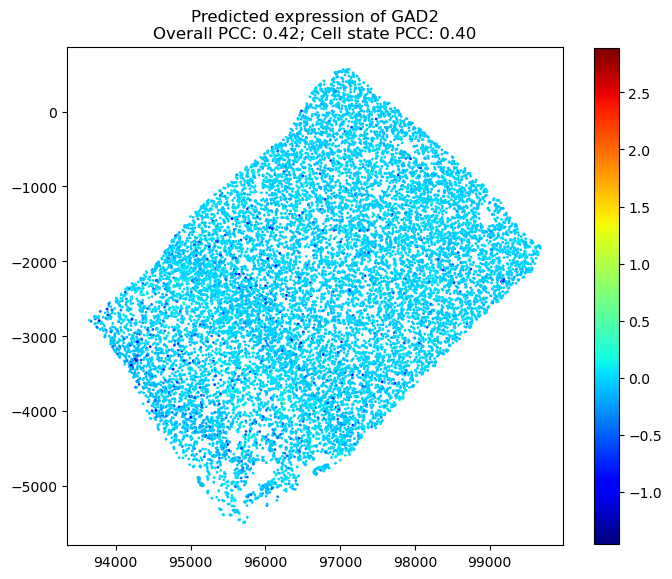

Plotting NTNG2 with PCC: 0.40


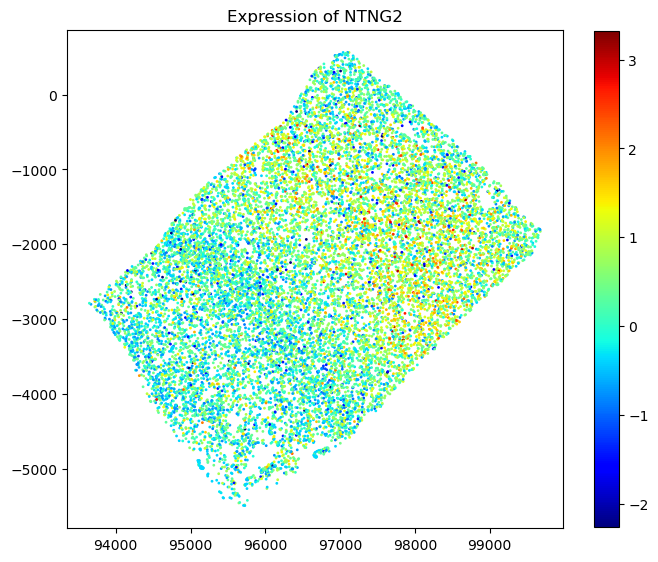

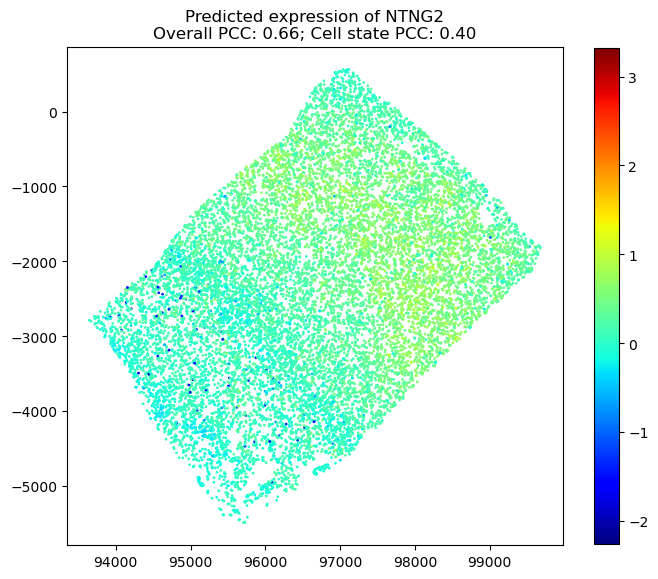

Plotting DCN with PCC: 0.39


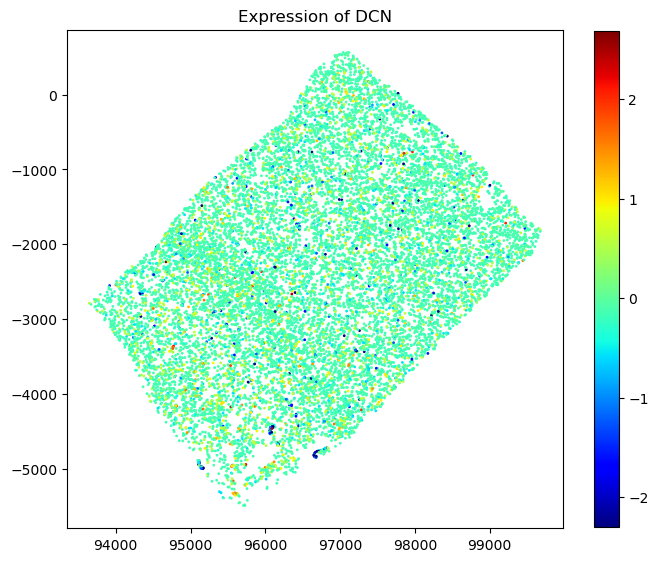

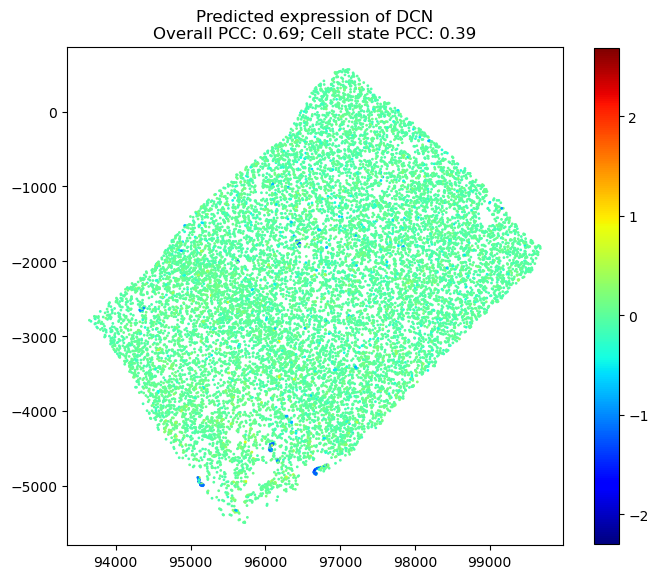

Plotting HS3ST2 with PCC: 0.39


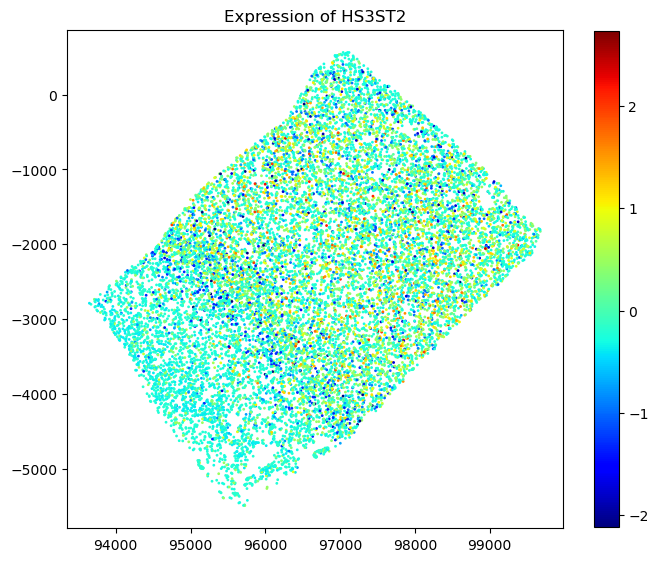

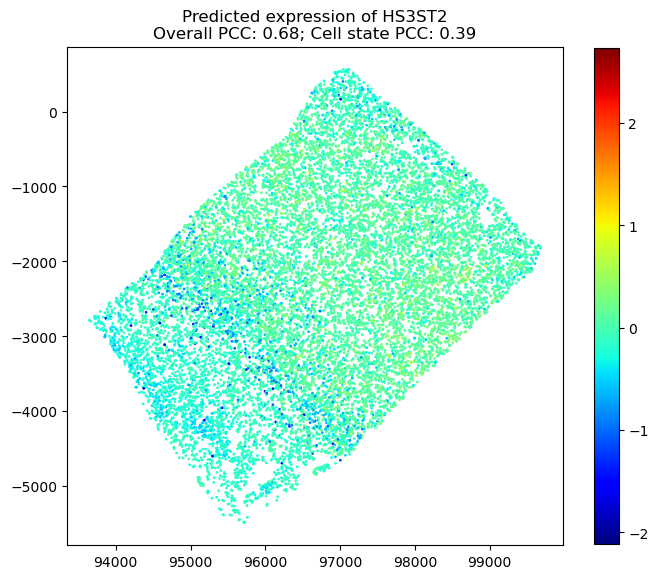

Plotting FRMPD4 with PCC: 0.39


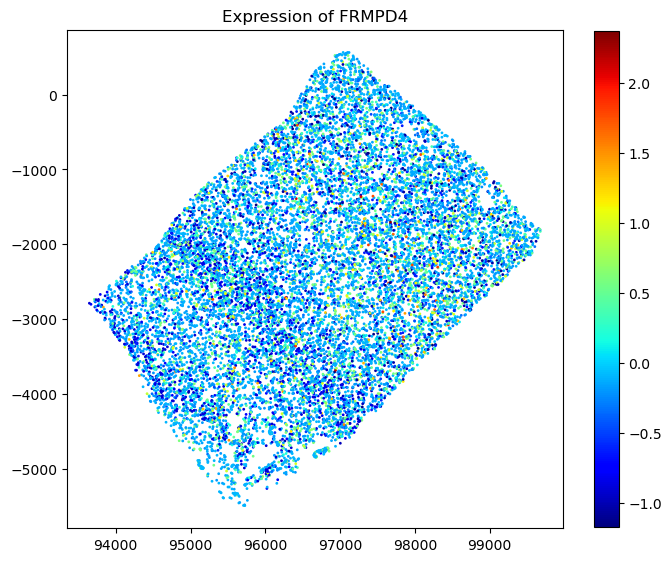

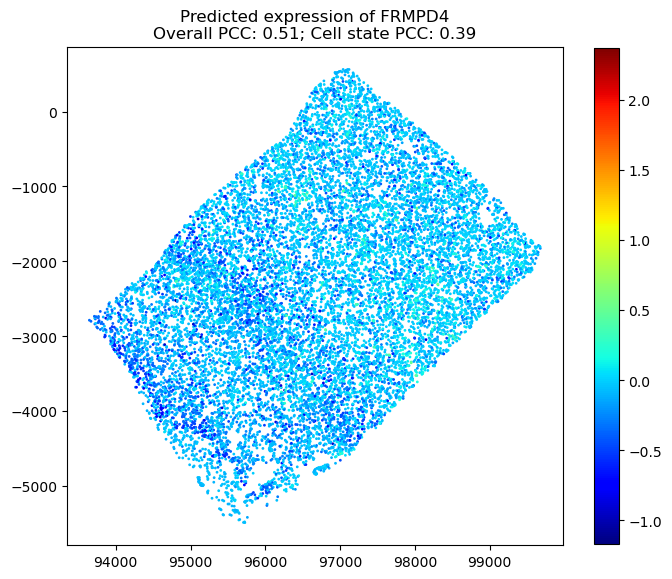

Plotting RORB with PCC: 0.39


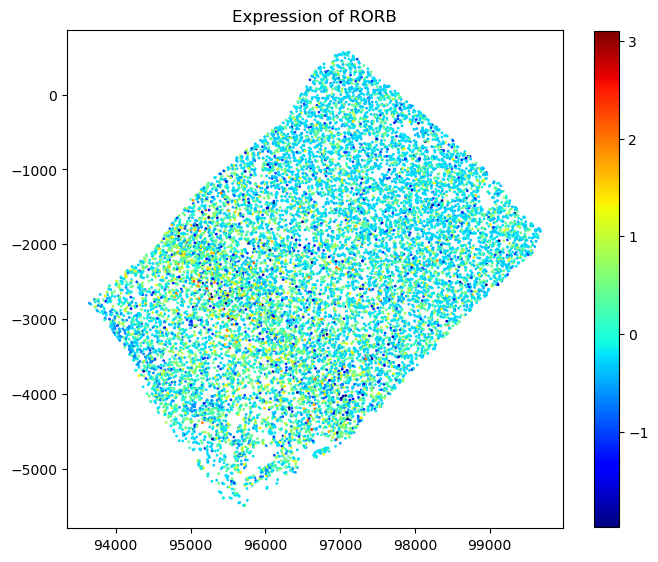

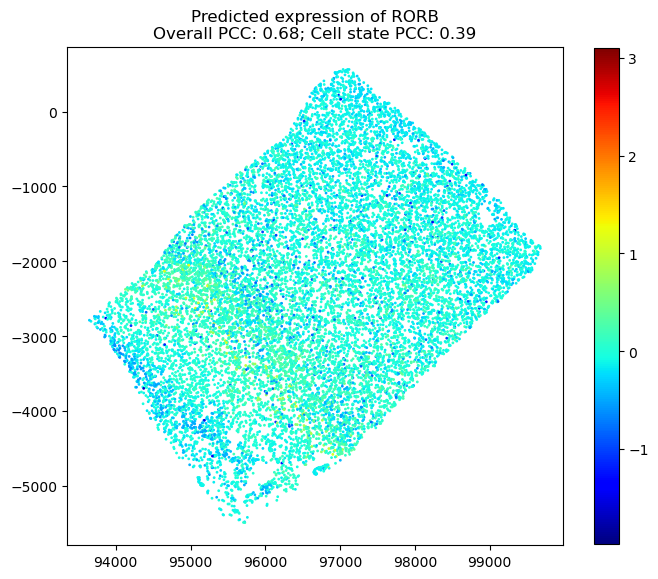

In [6]:
def find_top_genes_by_pcc(adata1, adata2, top_n=6):
    pcc_dict = {}
    for gene in adata1.var_names:
        pcc = calculate_pcc(adata1, adata2, gene)
        pcc_dict[gene] = pcc

    # Sort genes by their PCC in descending order and select top_n genes
    print(sorted(pcc_dict, key=pcc_dict.get, reverse=True))
    top_genes = sorted(pcc_dict, key=pcc_dict.get, reverse=True)[:top_n]
    print(top_genes)
    return top_genes

def plot_top_genes(adata_pred, adata_ground, top_n=20, normalize_expression=False, colorbar_size=0.8):
    top_genes = find_top_genes_by_pcc(adata_pred, adata_ground, top_n=top_n)#+["Bdnf","Chat","Gad1"]
    for gene in top_genes:
        print(f"Plotting {gene} with PCC: {calculate_pcc(adata_pred, adata_ground, gene):.2f}")
        spatial_visualize_gene(adata_pred, adata_ground, gene, normalize_expression=normalize_expression, colorbar_size=colorbar_size)
    return top_genes

gene0=plot_top_genes(adata_pred,adata_y)

['CD22', 'MOG', 'RYR3', 'RBFOX3', 'TNR', 'CLSTN2', 'CUX2', 'LAMP5', 'DLC1', 'GRIK3', 'EBF1', 'DCN', 'GRM7', 'CNTNAP5', 'GRIN2A', 'HS3ST2', 'RORB', 'CSMD1', 'SLC32A1', 'KIRREL3', 'TMEM132D', 'NTNG2', 'TENM2', 'PAX6', 'PEX5L', 'NOSTRIN', 'SLC14A1', 'LRRK1', 'DCLK1', 'SATB2', 'SLC24A2', 'ANK1', 'ATRNL1', 'ID3', 'ETNPPL', 'DGKG', 'SOX6', 'SORCS3', 'FEZF2', 'RBFOX1', 'ASIC2', 'GRIP2', 'SLIT3', 'CD74', 'KIAA1217', 'HCN1', 'PALMD', 'RGS6', 'COL11A1', 'CACNA2D3', 'CBLN2', 'CA10', 'DCC', 'ZMAT4', 'SORCS1', 'GPC5', 'KAZN', 'LHX6', 'GRIP1', 'TOX', 'ROBO2', 'BTBD11', 'PRKG1', 'LAMA4', 'CACHD1', 'NKAIN2', 'LUZP2', 'DACH1', 'SNTB1', 'CDH6', 'HTR2C', 'MEIS2', 'LRP1B', 'SMYD1', 'ASTN2', 'SEMA3E', 'GRIN3A', 'HS6ST3', 'PDZD2', 'ADAMTSL1', 'FRMPD4', 'PRRT4', 'HTR2A', 'ITGA8', 'CNTN5', 'PLCB1', 'LRRC4C', 'ZNF385D', 'DLX1', 'ROBO1', 'ADAMTS3', 'EGFR', 'TMEM255A', 'GRID2', 'UNC5B', 'PDE4B', 'SULF1', 'NRG1', 'KCNIP4', 'NOS1', 'SEMA6D', 'ZNF804A', 'PVALB', 'RFX3', 'NPAS3', 'TAFA1', 'GAD2', 'FBXL7', 'TACR1', '

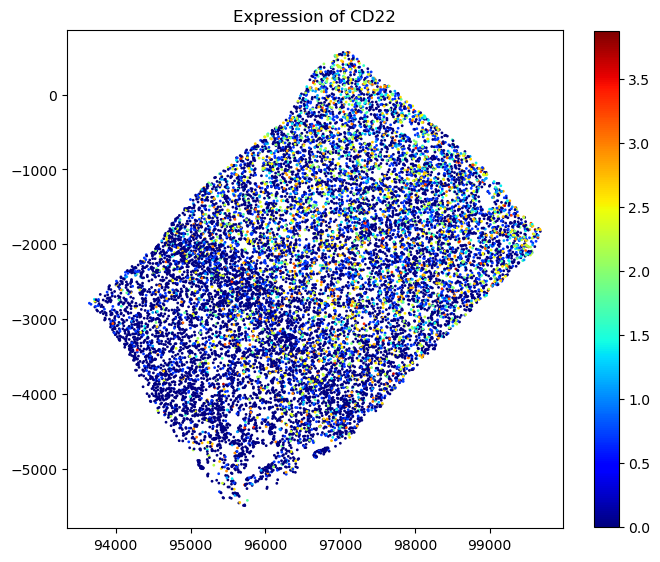

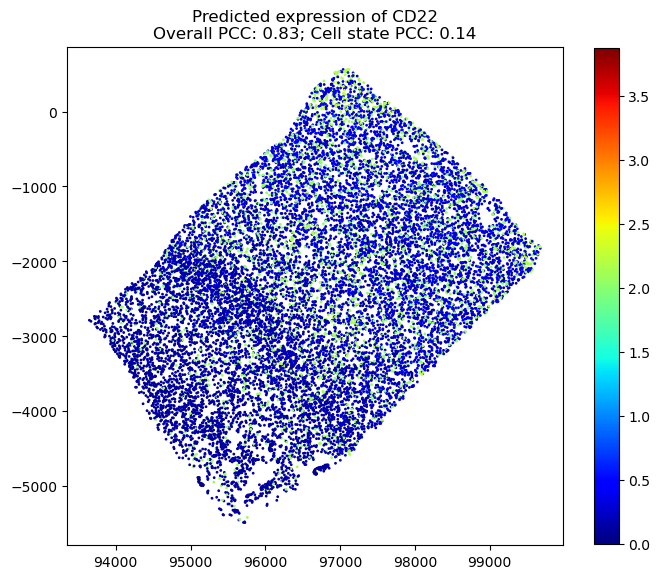

Plotting MOG with PCC: 0.82


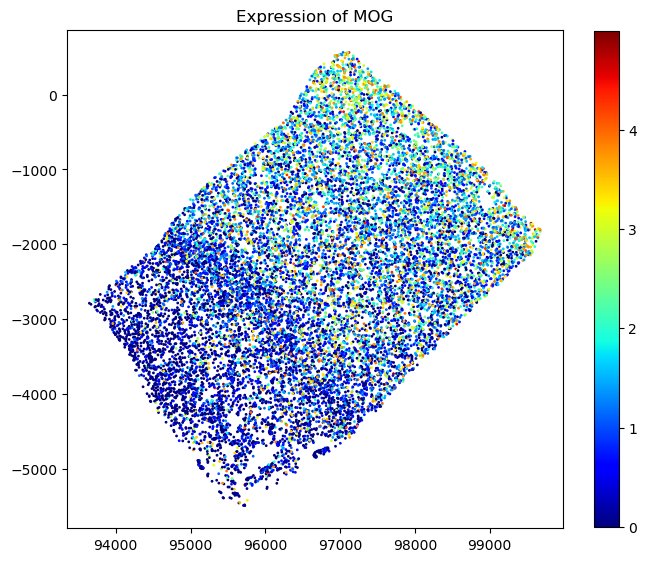

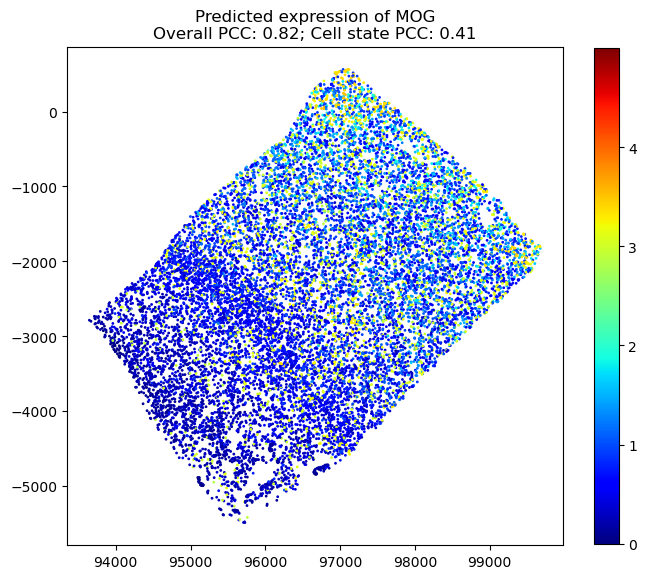

Plotting RYR3 with PCC: 0.78


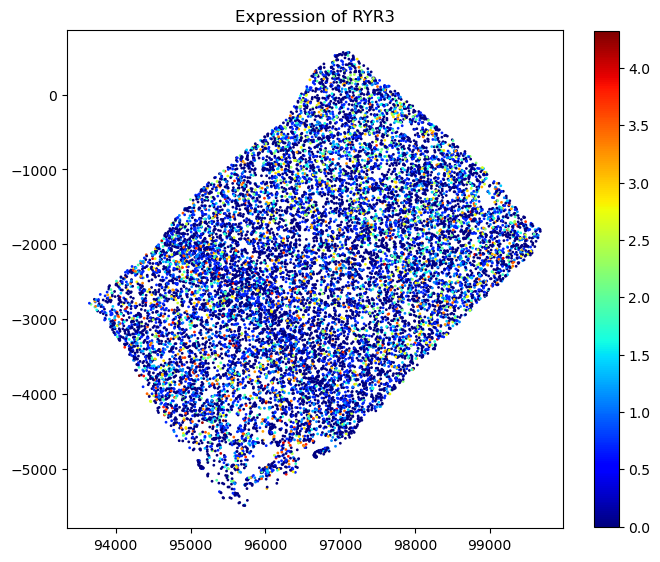

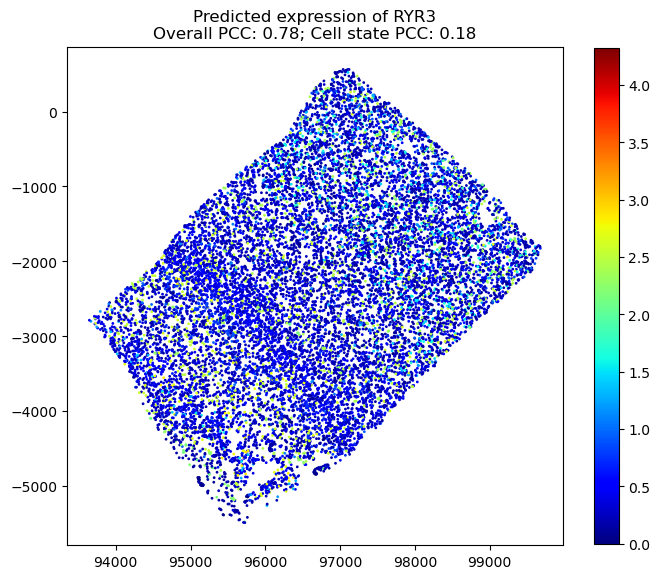

Plotting RBFOX3 with PCC: 0.76


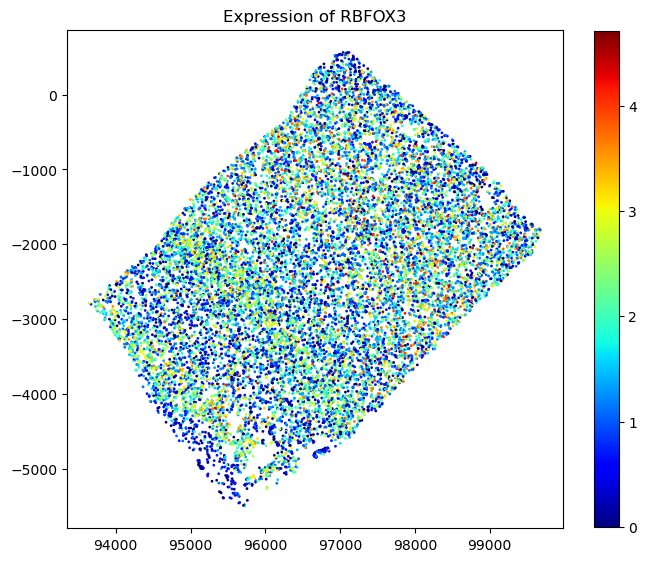

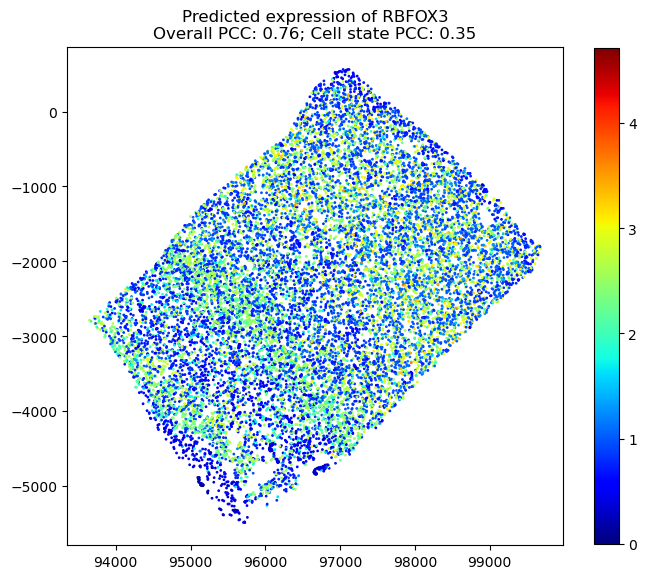

Plotting TNR with PCC: 0.73


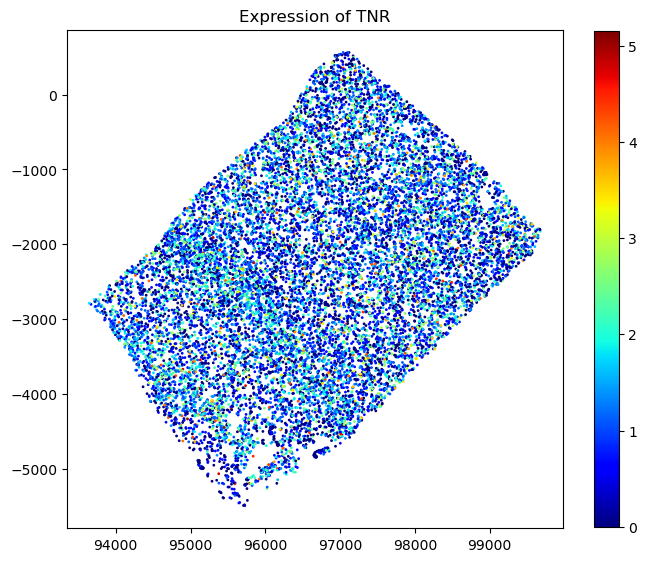

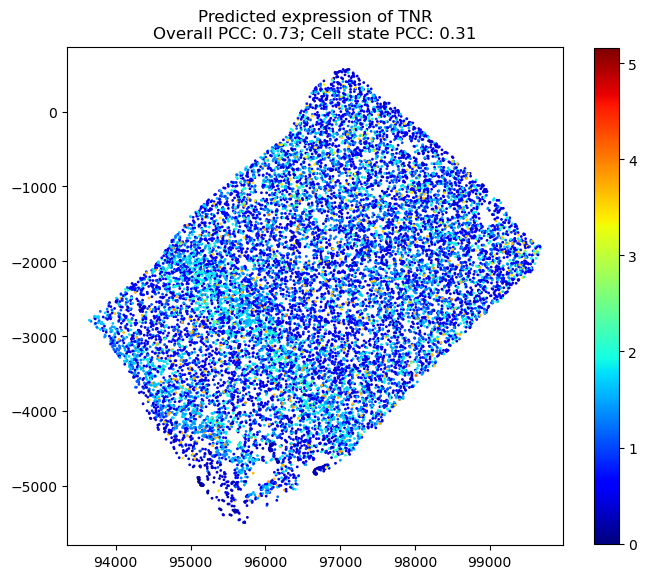

Plotting CLSTN2 with PCC: 0.73


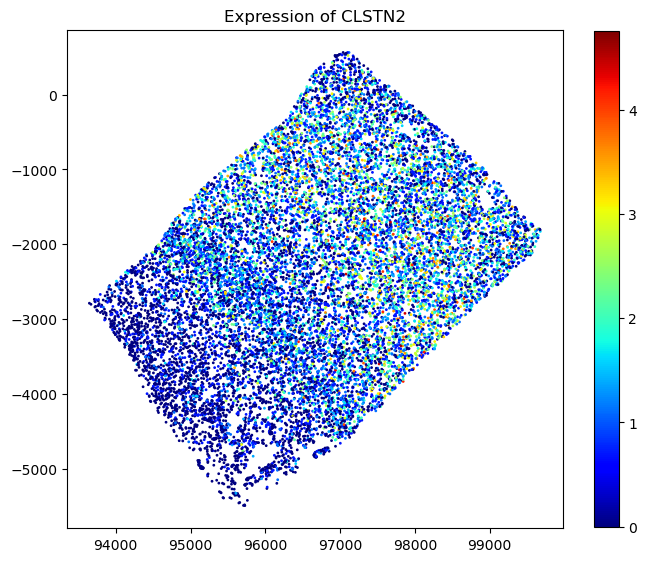

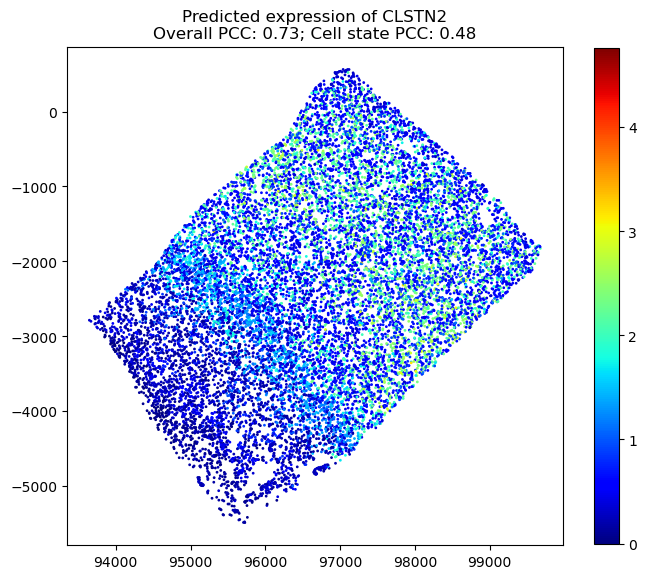

Plotting CUX2 with PCC: 0.72


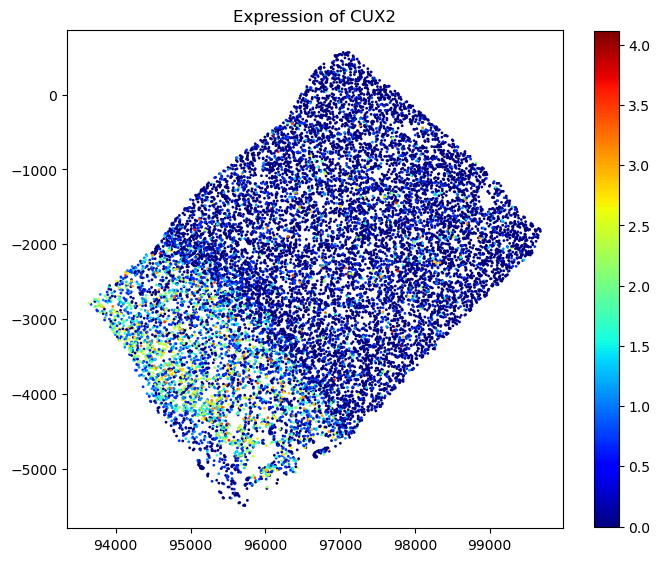

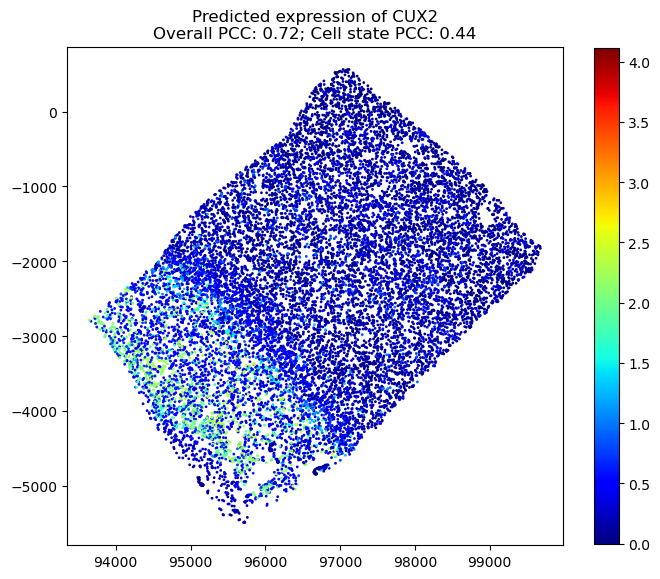

Plotting LAMP5 with PCC: 0.72


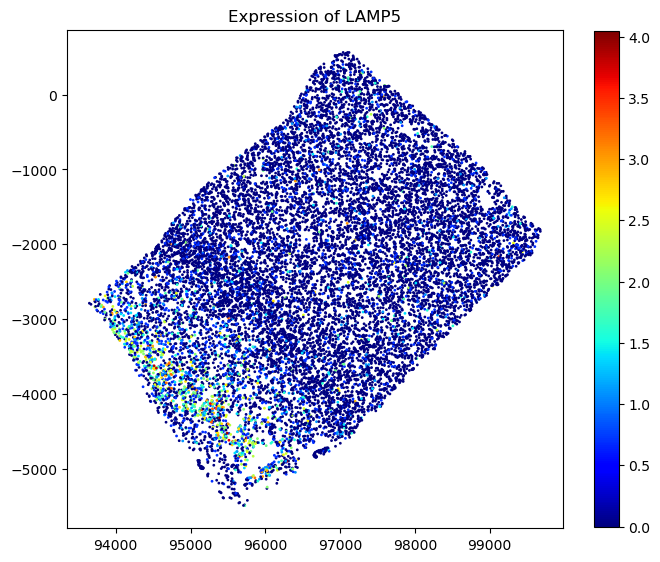

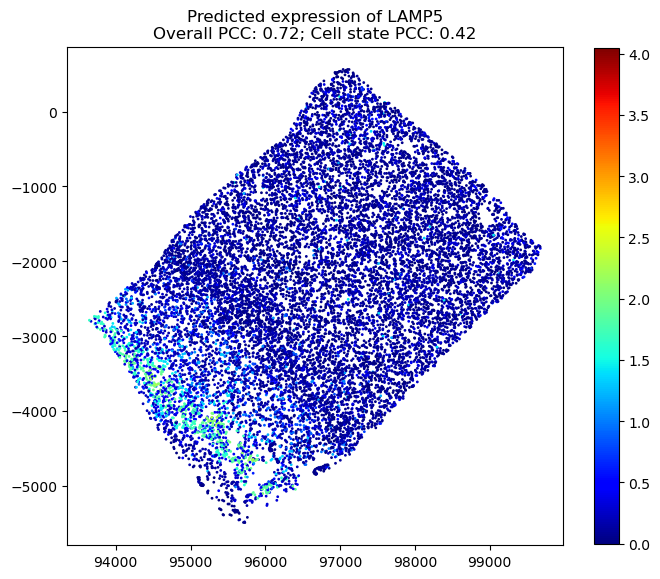

Plotting DLC1 with PCC: 0.70


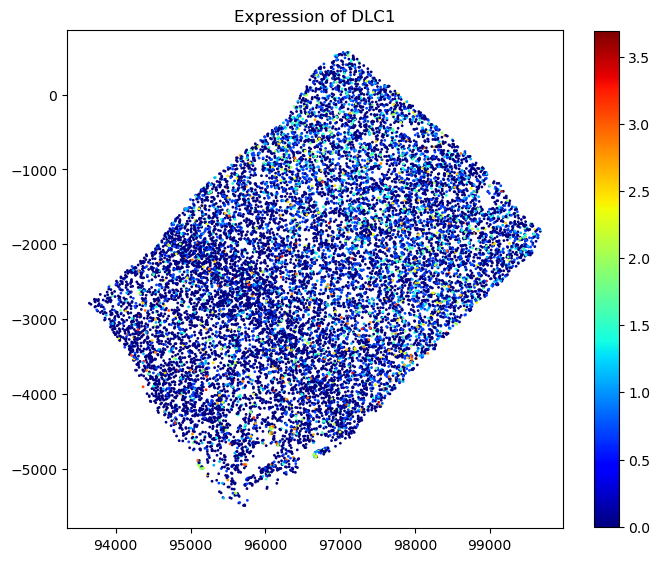

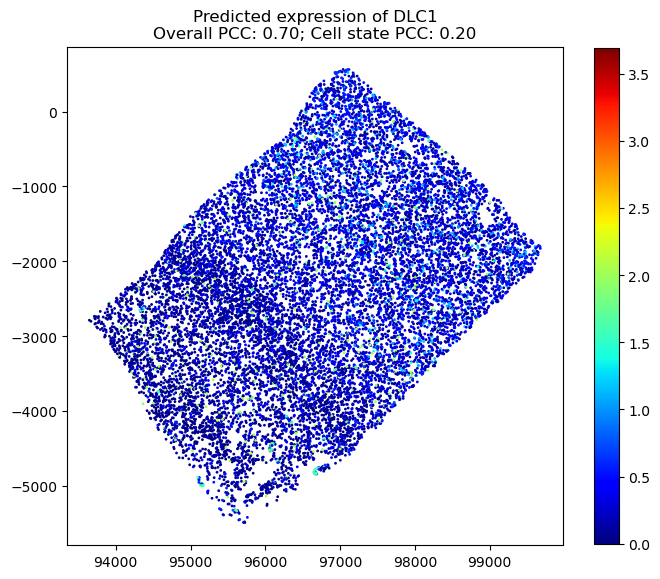

Plotting GRIK3 with PCC: 0.70


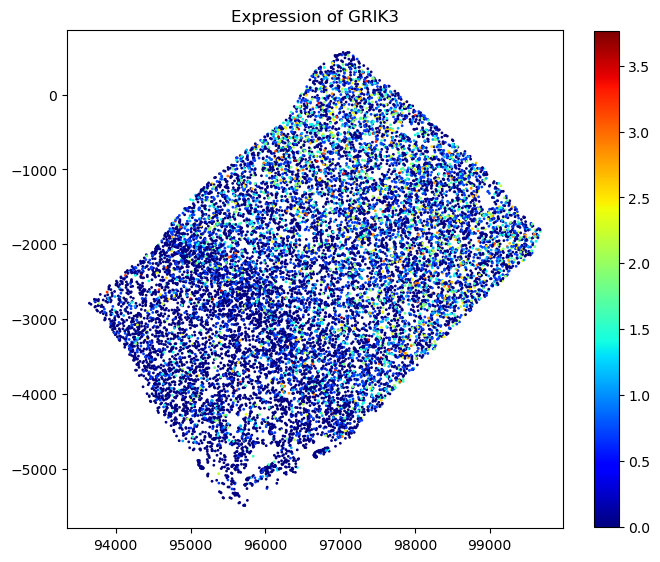

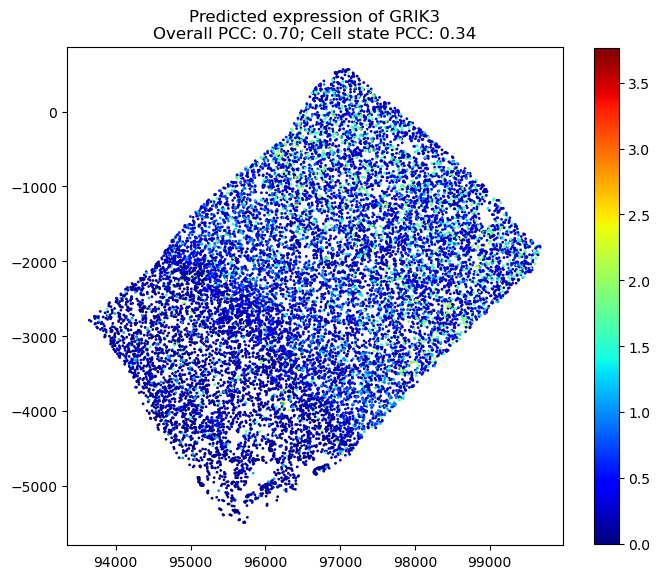

Plotting EBF1 with PCC: 0.70


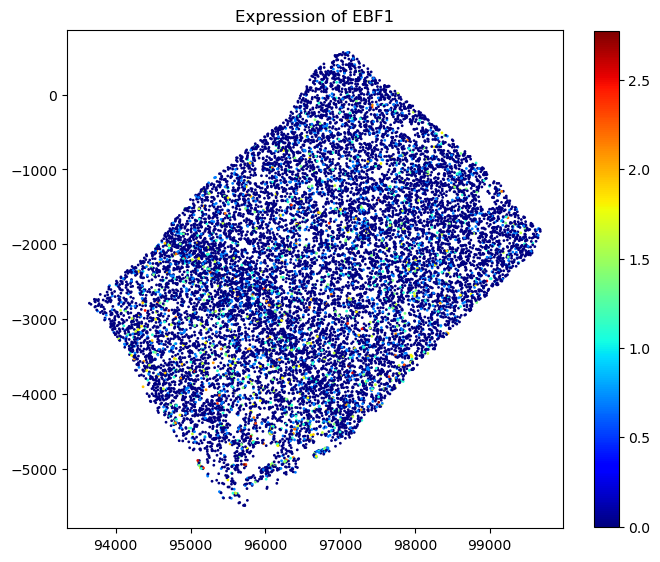

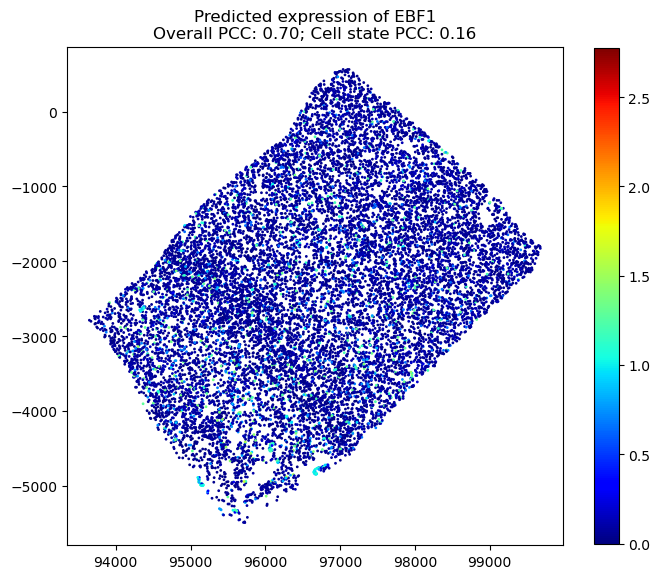

Plotting DCN with PCC: 0.69


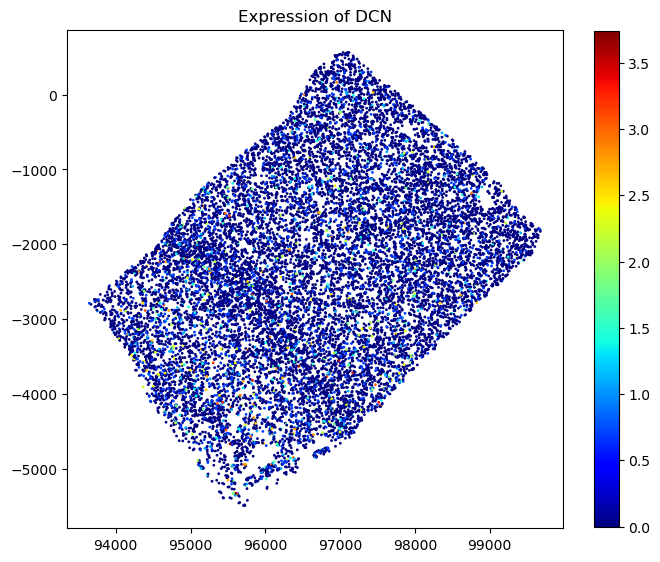

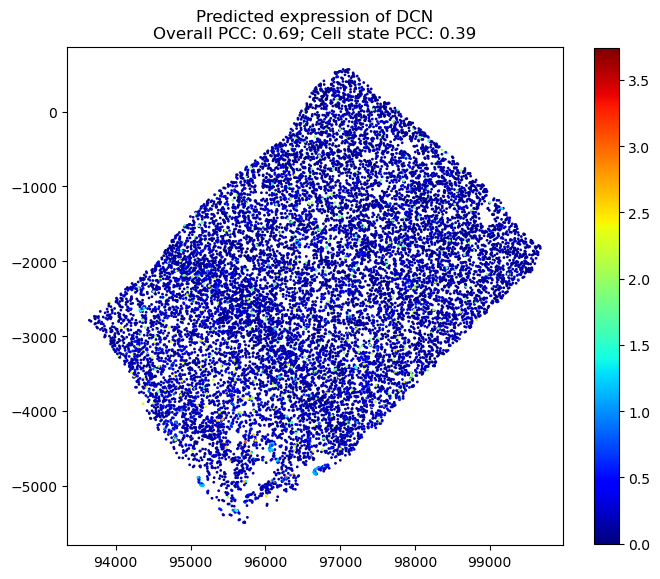

Plotting GRM7 with PCC: 0.69


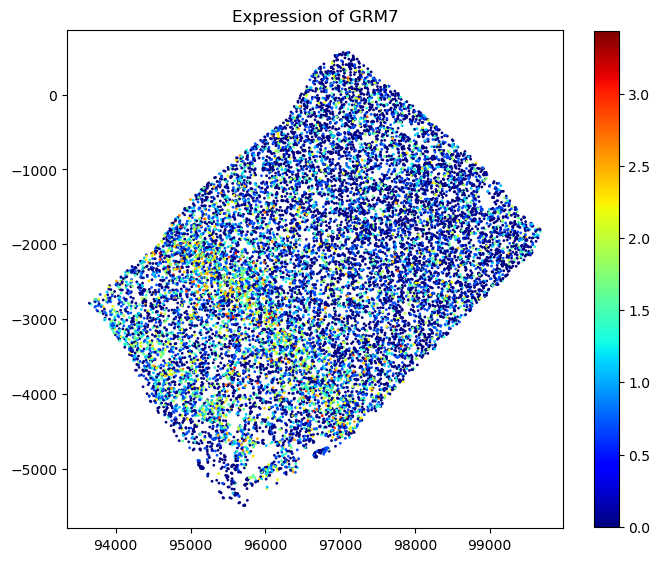

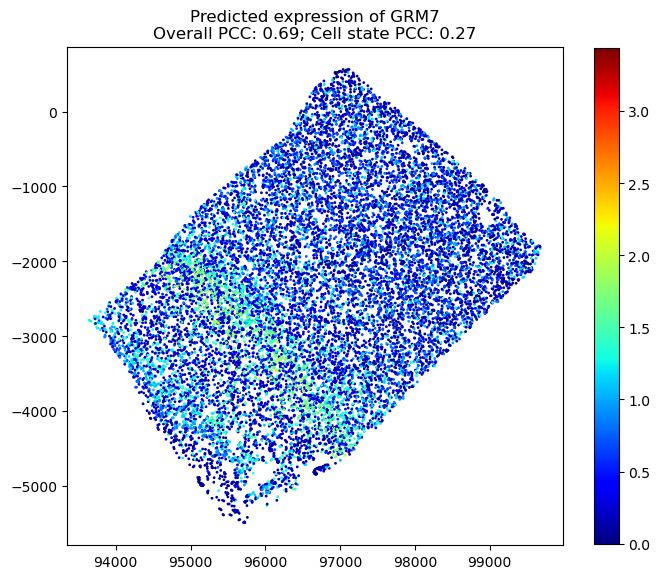

Plotting CNTNAP5 with PCC: 0.69


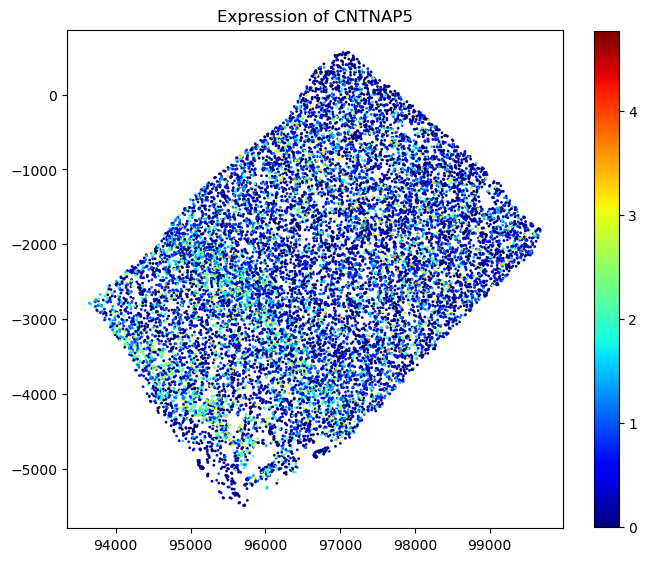

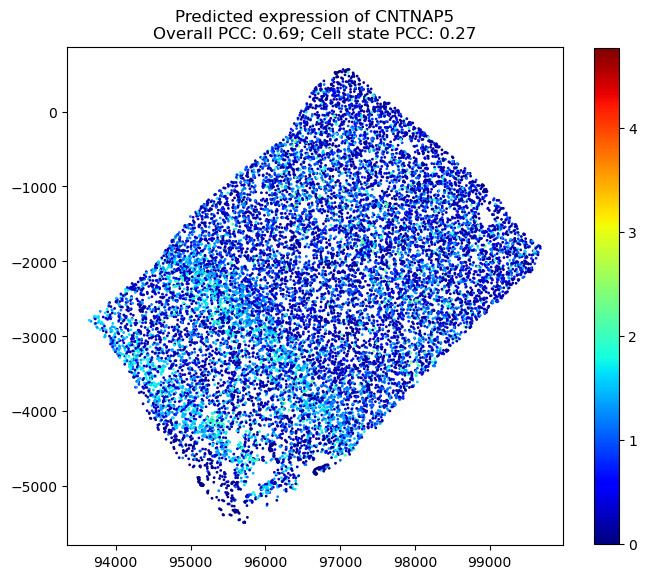

Plotting GRIN2A with PCC: 0.68


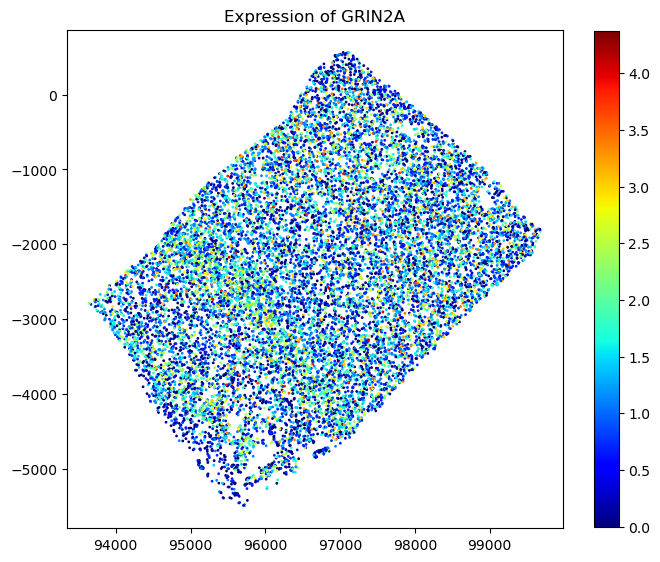

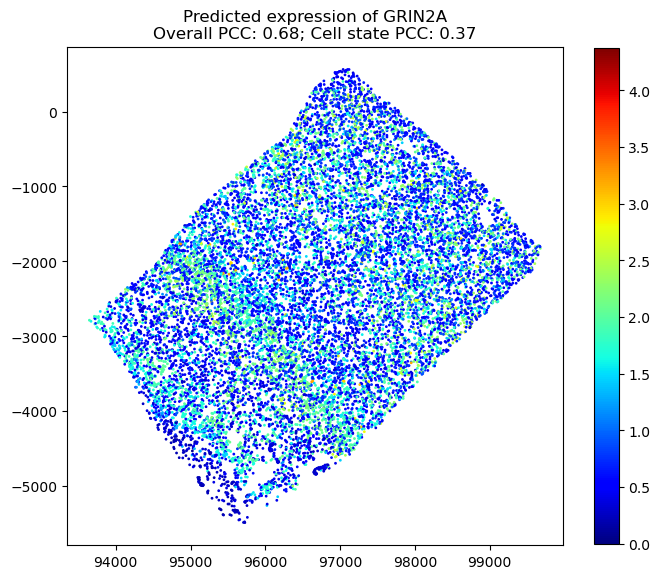

Plotting HS3ST2 with PCC: 0.68


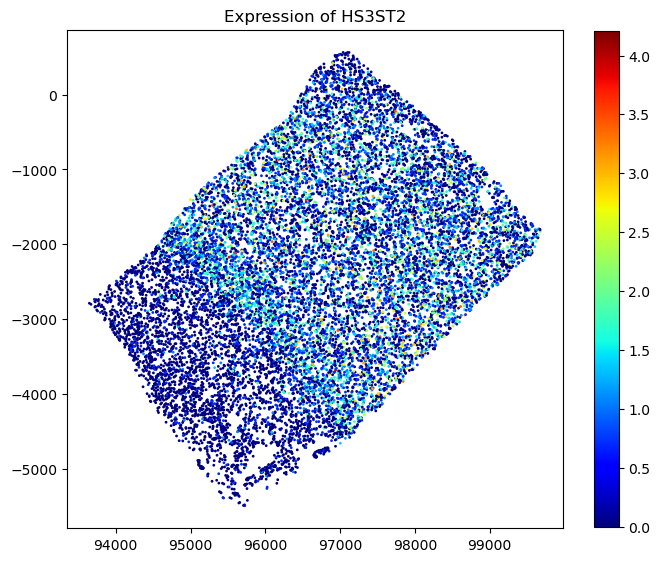

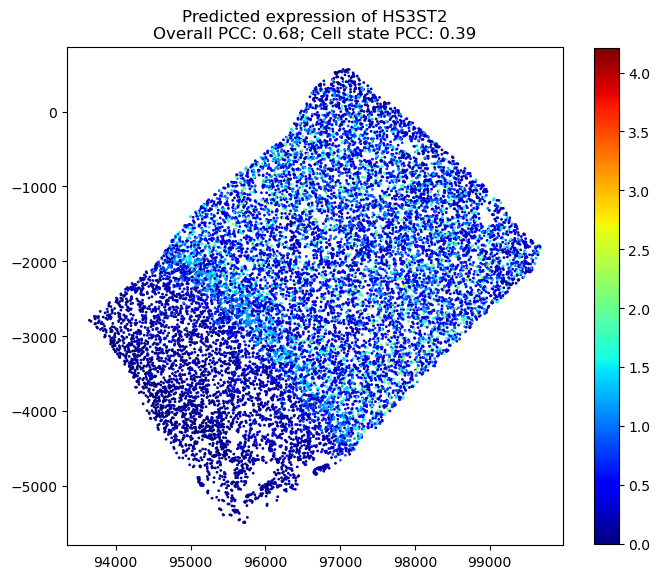

Plotting RORB with PCC: 0.68


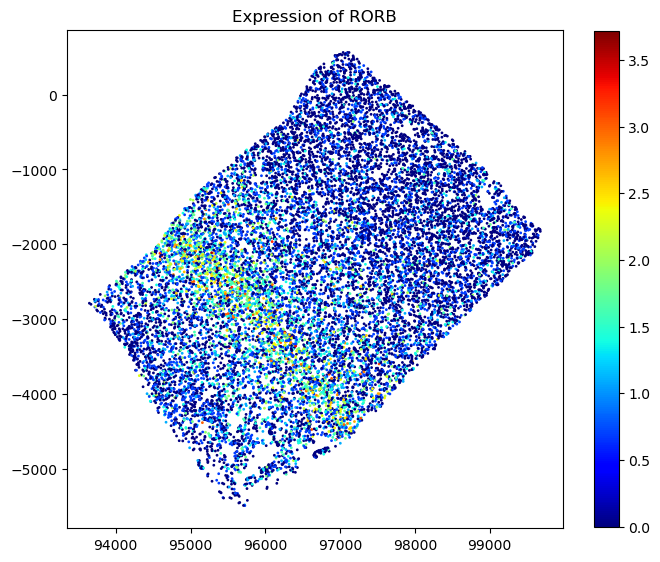

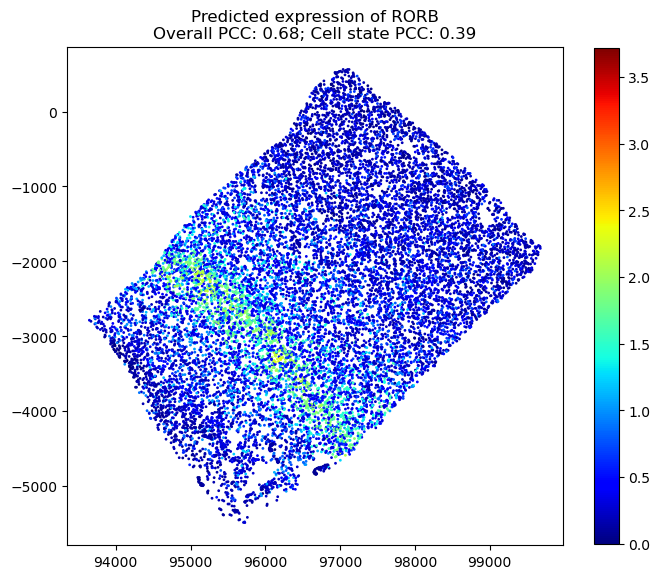

Plotting CSMD1 with PCC: 0.68


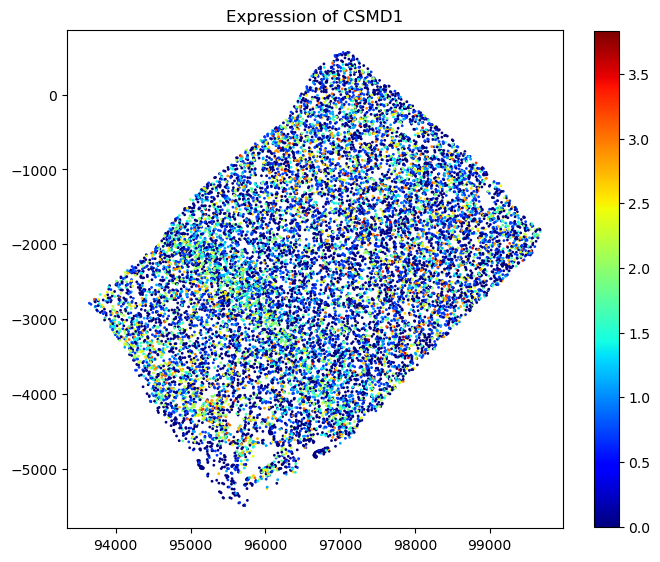

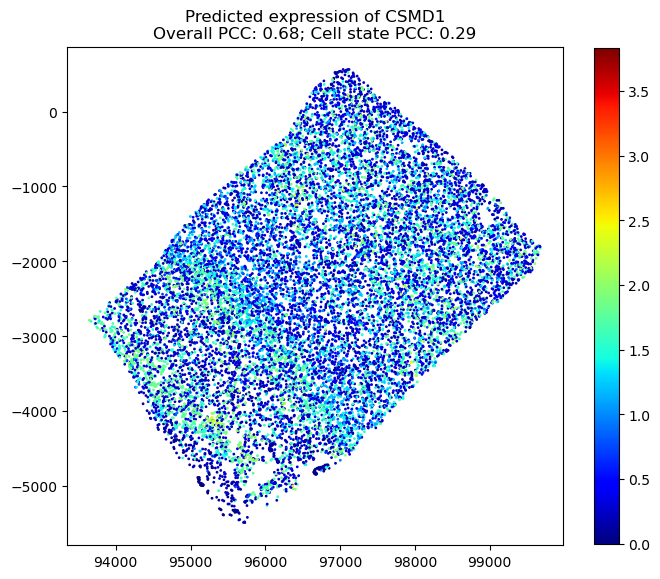

Plotting SLC32A1 with PCC: 0.68


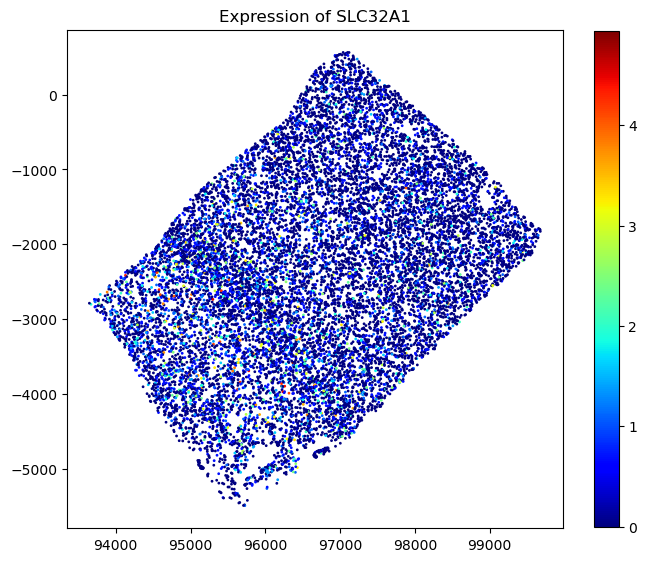

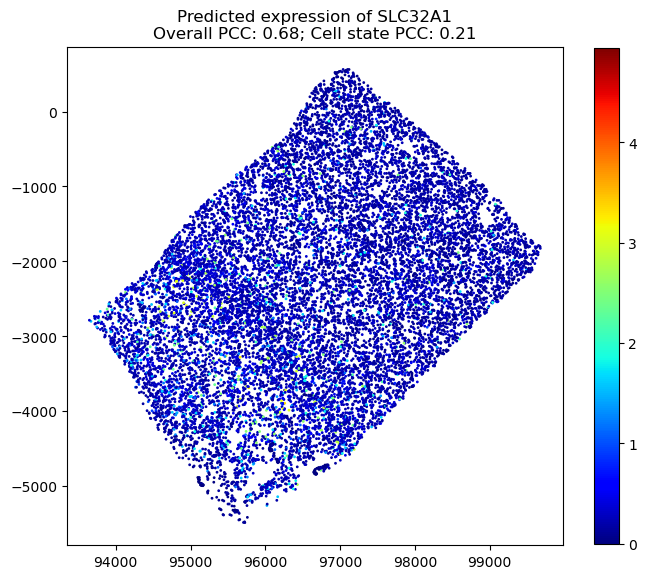

Plotting KIRREL3 with PCC: 0.67


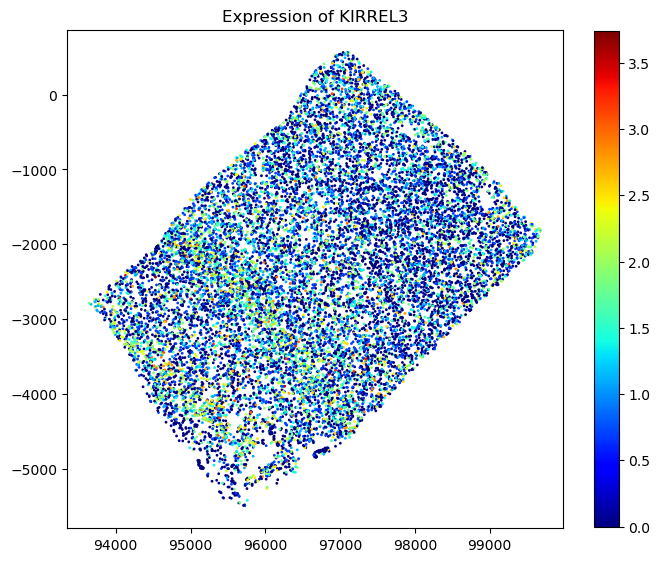

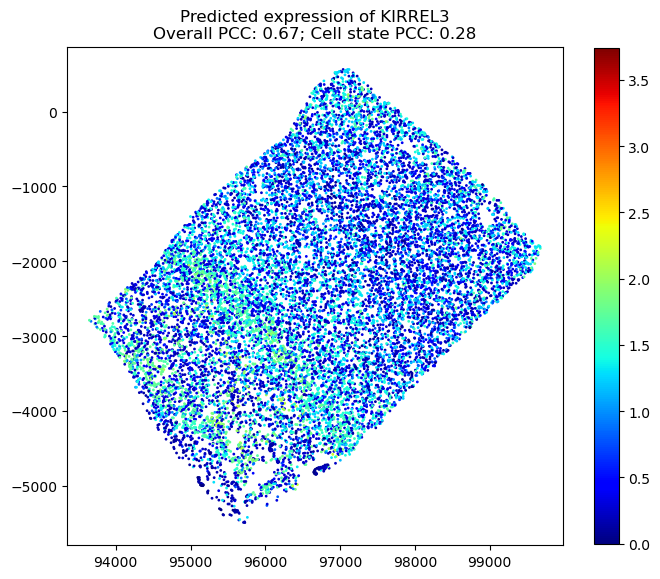

In [7]:
gene1=plot_top_genes(adata_pred1,adata_y1)

['CUX2', 'HS3ST2', 'RORB', 'CLSTN2', 'MOG', 'DCN', 'LAMP5']


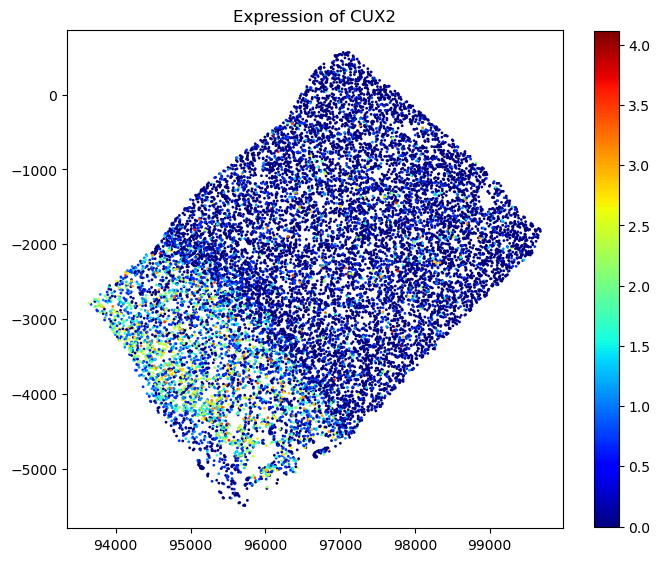

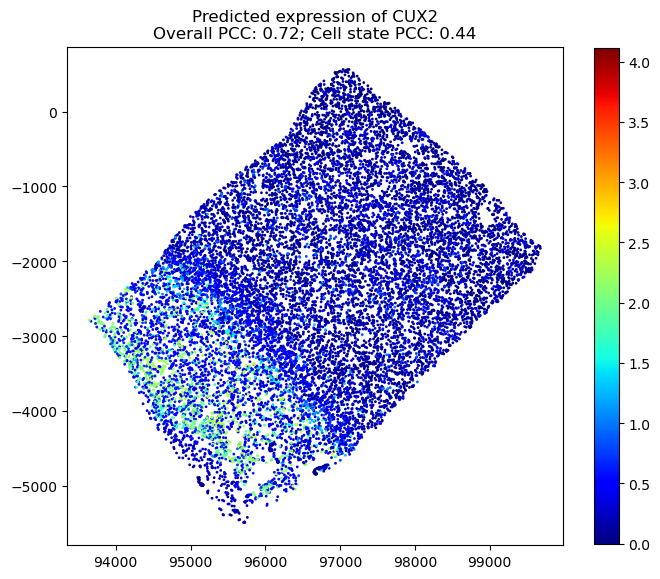

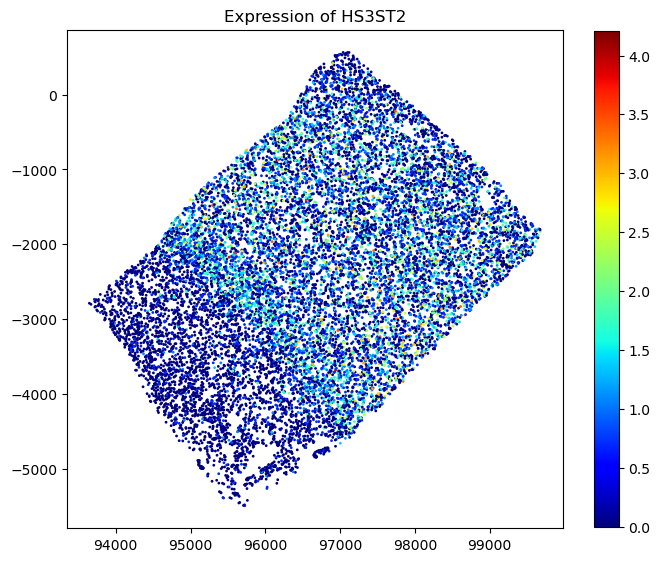

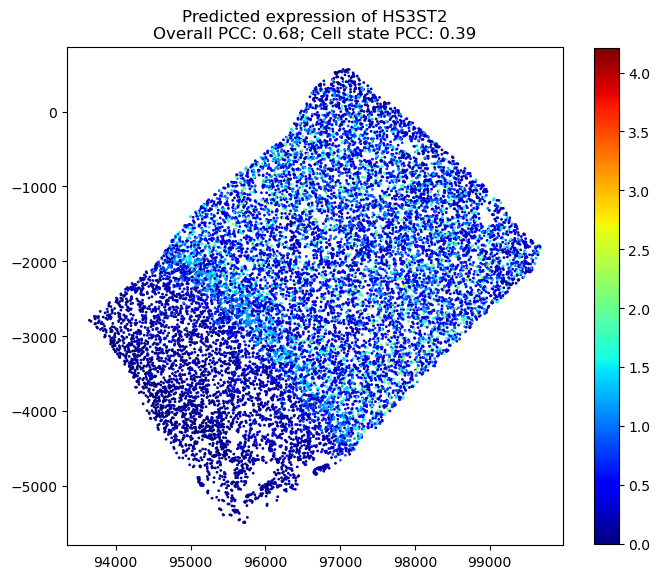

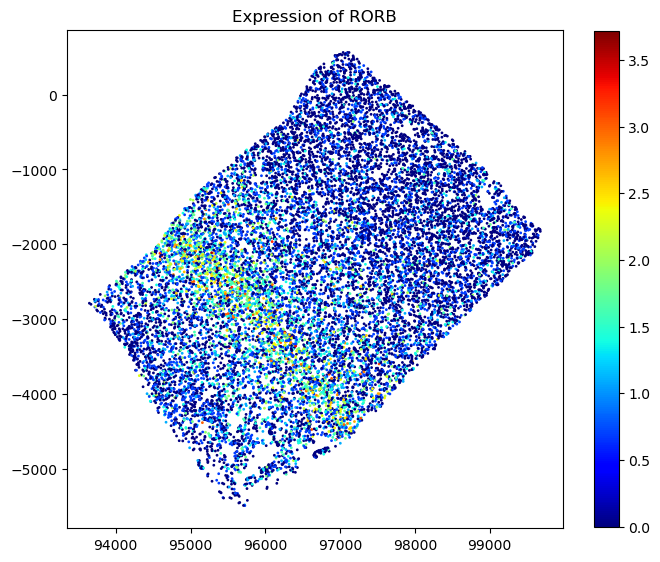

...

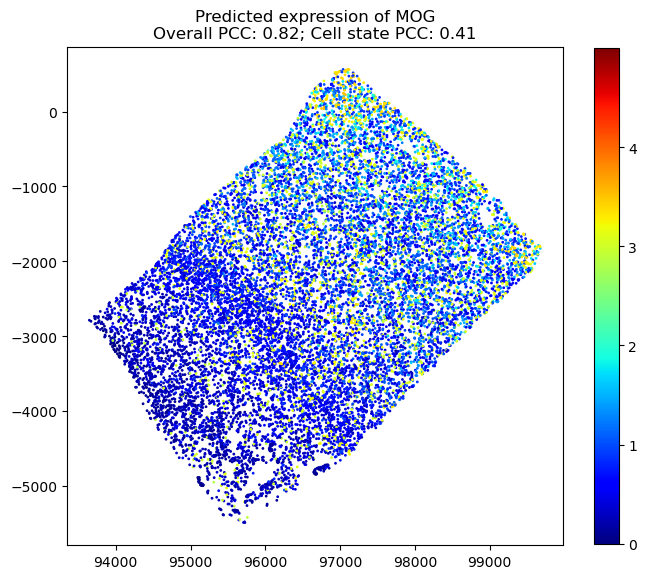

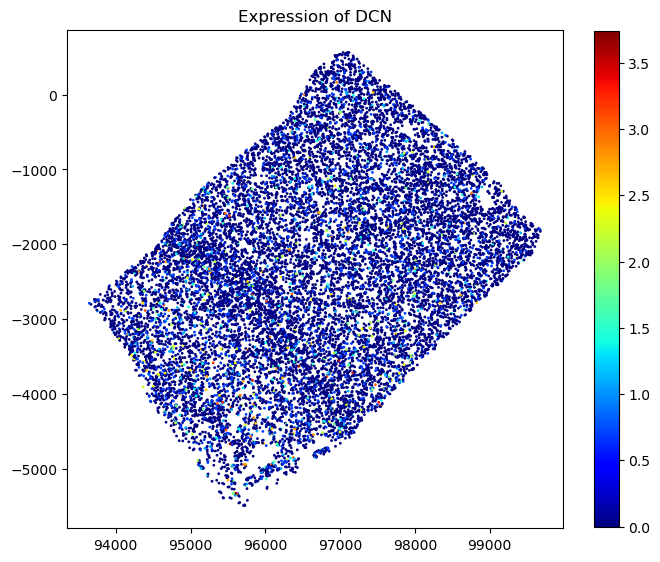

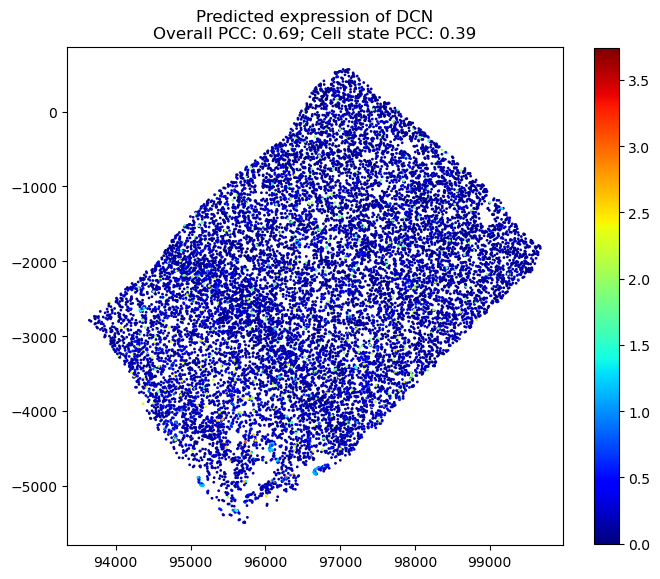

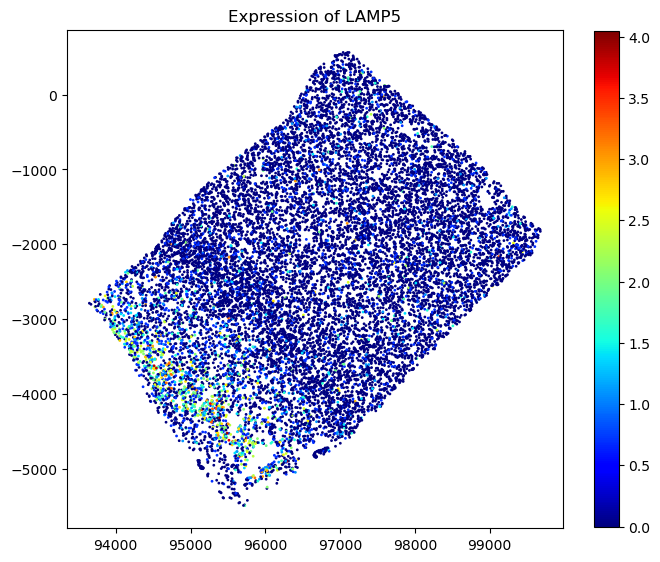

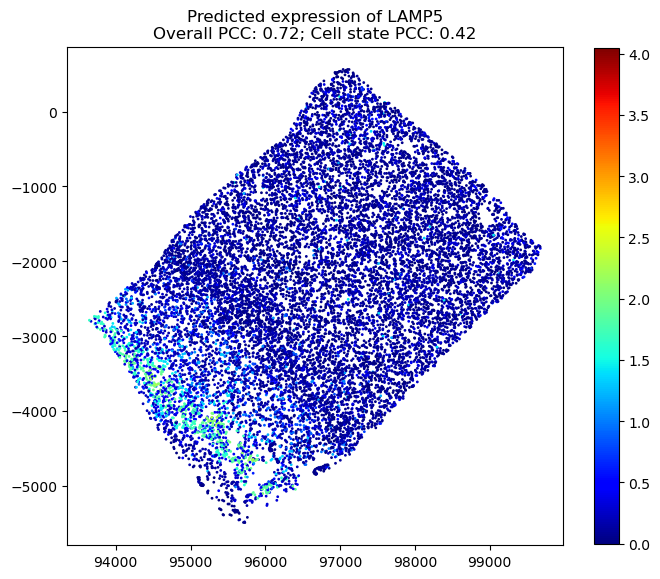

In [8]:
print(list(set(gene0).intersection(gene1)))
for gene in list(set(gene0).intersection(gene1)):
    spatial_visualize_gene(adata_pred1, adata_y1, gene, normalize_expression=False, colorbar_size=0.8)

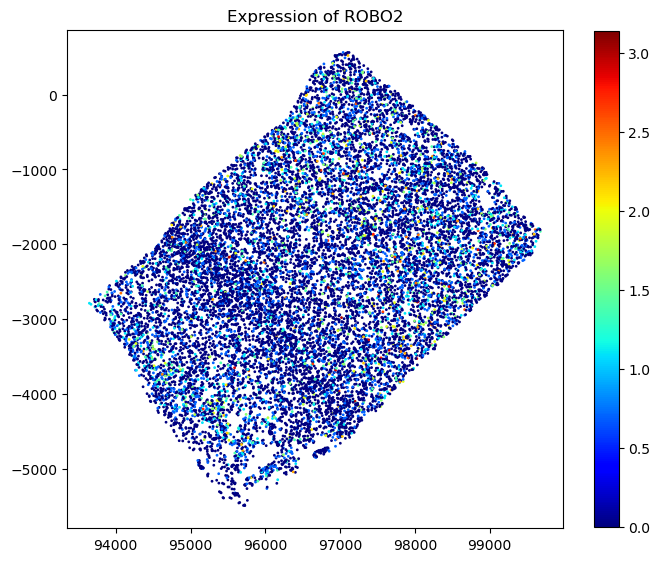

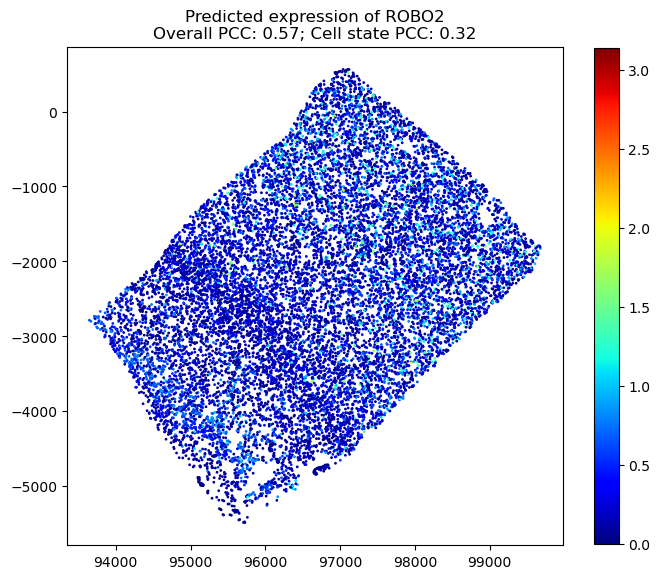

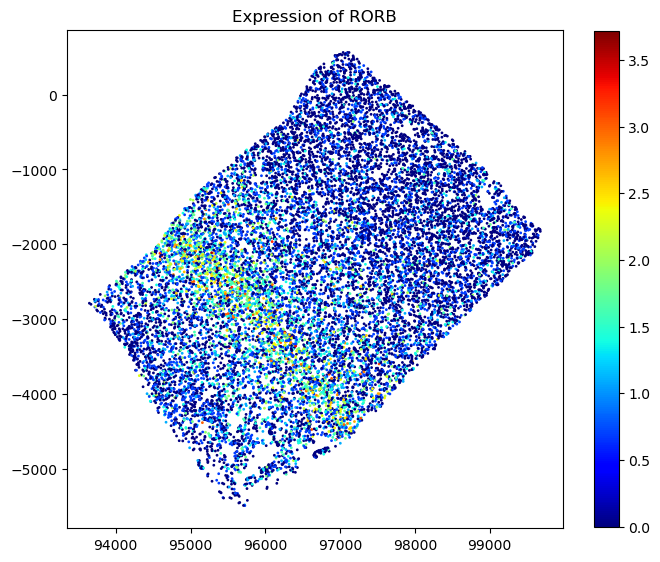

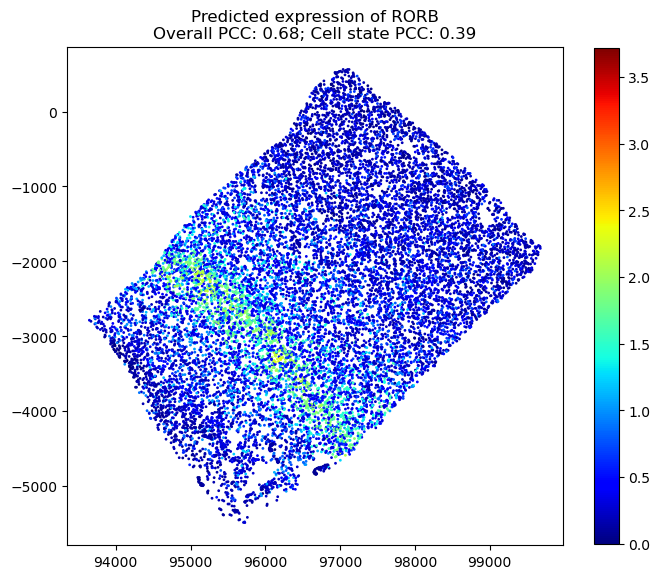

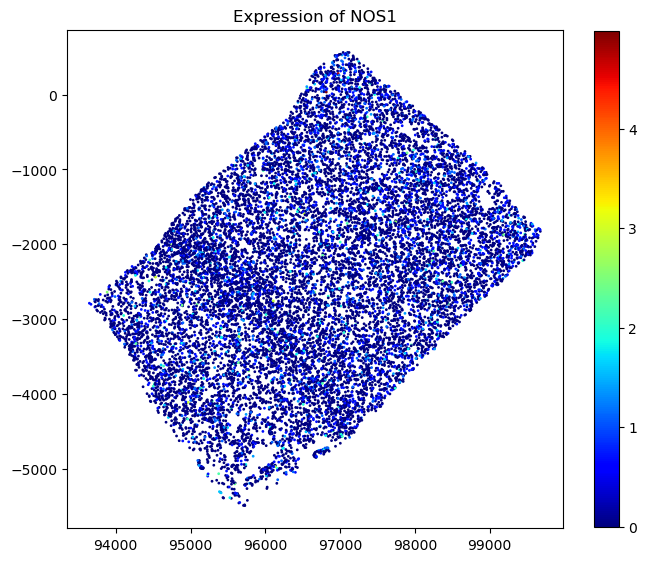

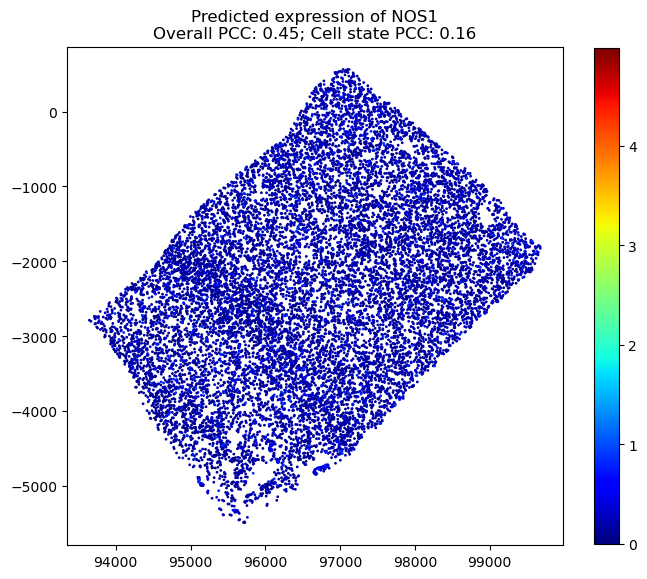

In [9]:
spatial_visualize_gene(adata_pred1, adata_y1, "ROBO2", normalize_expression=False, colorbar_size=0.8)
spatial_visualize_gene(adata_pred1, adata_y1, "RORB", normalize_expression=False, colorbar_size=0.8)
spatial_visualize_gene(adata_pred1, adata_y1, "NOS1", normalize_expression=False, colorbar_size=0.8)